# Autoencoders

В этом ноутбуке мы будем тренировать автоэнкодеры кодировать лица людей. Для этого возьмем следующий датасет: "Labeled Faces in the Wild" (LFW) (http://vis-www.cs.umass.edu/lfw/). Код для скачивания и загрузки датасета написан за вас в файле get_dataset.py


# Vanilla Autoencoder (2 балла)

## Prepare the data


In [ ]:
import numpy as np

from torch.autograd import Variable
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.utils.data as data_utils

import torch
import torchvision

import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import clear_output

In [ ]:
import pandas as pd
from math import floor
import torchsummary
from copy import deepcopy

from sklearn.manifold import TSNE
from scipy.stats import norm

import torchvision.transforms as transforms
from PIL import Image
import random

In [ ]:
from google.colab import files, drive
drive.mount("/content/gdrive/", force_remount=True)

Mounted at /content/gdrive/


In [ ]:
# The following line fetches you two datasets: images, usable for autoencoder training and attributes.
# Those attributes will be required for the final part of the assignment (applying smiles), so please keep them in mind
from get_dataset import fetch_dataset
data, attrs = fetch_dataset()

images not found, donwloading...
extracting...
done
attributes not found, downloading...
done


In [ ]:
data.shape

(13143, 45, 45, 3)

In [ ]:
pd.Series( data[0].flatten() ).describe()

count    6075.000000
mean        0.499980
std         0.195427
min         0.000980
25%         0.350000
50%         0.500980
75%         0.634314
max         0.923529
dtype: float64

In [ ]:
attrs.shape

(13143, 73)

In [ ]:
attrs.head()

,Male,Asian,White,Black,Baby,Child,Youth,Middle Aged,Senior,Black Hair,Blond Hair,Brown Hair,Bald,No Eyewear,Eyeglasses,Sunglasses,Mustache,Smiling,Frowning,Chubby,Blurry,Harsh Lighting,Flash,Soft Lighting,Outdoor,Curly Hair,Wavy Hair,Straight Hair,Receding Hairline,Bangs,Sideburns,Fully Visible Forehead,Partially Visible Forehead,Obstructed Forehead,Bushy Eyebrows,Arched Eyebrows,Narrow Eyes,Eyes Open,Big Nose,Pointy Nose,Big Lips,Mouth Closed,Mouth Slightly Open,Mouth Wide Open,Teeth Not Visible,No Beard,Goatee,Round Jaw,Double Chin,Wearing Hat,Oval Face,Square Face,Round Face,Color Photo,Posed Photo,Attractive Man,Attractive Woman,Indian,Gray Hair,Bags Under Eyes,Heavy Makeup,Rosy Cheeks,Shiny Skin,Pale Skin,5 o' Clock Shadow,Strong Nose-Mouth Lines,Wearing Lipstick,Flushed Face,High Cheekbones,Brown Eyes,Wearing Earrings,Wearing Necktie,Wearing Necklace
0,1.56835,-1.88904,1.7372,-0.929729,-1.4718,-0.19558,-0.835609,-0.351468,-1.01253,-0.719593,-0.632401,0.464839,-0.973528,1.56519,-1.2967,-1.54272,-0.684671,-0.86499,0.766886,-0.218952,-1.65567,-0.787044,-0.599665,0.458519,0.18976,0.851555,-0.38572,-0.497719,-0.161149,-0.257514,-0.0888388,0.455469,-0.839211,-0.0229481,-0.922568,-0.114539,1.46122,1.75848,0.0688935,1.26786,-1.12024,0.917617,-1.30796,-1.50041,1.02922,0.832363,-0.498657,0.251365,-0.705281,-0.515715,0.374239,-0.168675,-0.614143,3.0977,1.52386,0.779278,-0.0714539,-1.24648,-0.769283,-0.725597,-1.82061,-2.07298,-0.960759,0.361738,1.16612,-1.16492,-1.13999,-2.37175,-1.29993,-0.414682,-1.1449,0.694007,-0.826609
1,0.169851,-0.982408,0.422709,-1.28218,-1.36006,-0.867002,-0.452293,-0.197521,-0.956073,-0.802107,-0.736883,0.294554,-1.27765,0.954771,-0.990992,-1.16736,-0.835146,0.798544,-0.971679,0.342826,-1.32256,0.962937,-1.19936,-0.157307,0.443224,-0.00288156,-0.0211584,-0.226563,-0.0810386,-0.827202,-0.106624,1.22759,-0.812223,-1.24126,0.0962725,-0.404544,0.325919,0.474452,1.13536,0.0587247,0.611176,-1.17251,0.428512,-0.874235,-1.19156,0.192359,-0.204166,0.342347,0.239512,-1.47469,0.236057,-0.565208,-0.712542,2.99708,-0.273306,-0.187722,-0.604608,-1.3217,-0.938559,0.494294,-0.659043,-1.14375,-0.775722,-0.832036,-0.39768,0.87416,-0.945431,-0.268649,-0.00624408,-0.0304057,-0.480128,0.66676,-0.496559
2,0.997749,-1.36419,-0.157377,-0.756447,-1.89183,-0.871526,-0.862893,0.0314447,-1.34152,-0.0900375,-1.20073,-0.33246,-0.537006,1.29836,-1.49847,-1.28582,1.14174,0.172817,0.106412,-0.788843,0.349295,-1.64372,0.454287,1.18946,-0.688414,-0.590574,-0.266673,0.467224,0.567348,-1.7191,0.124667,1.60274,-0.659399,-1.75376,1.20447,0.0221884,-1.13544,1.70286,-0.422144,0.587859,0.414363,0.344447,-1.26045,-0.577746,0.405567,-1.91655,0.92126,0.247437,-0.428451,-0.772273,0.370673,-0.509596,-0.768482,1.7069,0.126524,-0.497001,-0.393042,-0.178307,-1.18023,-0.596914,-1.80538,-0.951643,-0.838087,1.54974,1.88475,-0.999765,-1.35986,-1.91211,-1.09563,0.915126,-0.572332,0.144262,-0.841231
3,1.12272,-1.9978,1.91614,-2.51421,-2.58007,-1.40424,0.0575511,0.000195882,-1.27351,-1.43146,-0.0705188,-0.339239,-2.00415,0.665695,-0.77594,-1.47163,-1.17908,0.563327,-0.664429,-1.40793,0.435594,-0.589988,-1.6035,1.17074,0.760103,0.211498,-0.51618,-1.33115,0.20284,0.149645,-0.0464296,0.640885,-0.107616,-0.831271,-0.827005,-0.588725,0.429255,1.58766,0.499086,-0.0568692,-0.866643,-0.959689,0.35073,-1.33535,-0.42789,0.826817,-0.256779,0.149751,-1.20153,-1.08392,0.255363,-0.650423,-0.506293,1.10159,0.640783,1.57503,-0.484397,-1.55968,-1.43712,0.379363,-0.648233,-2.25735,-1.07561,0.567822,-0.176089,1.10812,-1.60094,-3.26461,0.813418,0.308631,-0.848693,0.475941,-0.447025
4,1.07821,-2.0081,1.67621,-2.27806,-2.65185,-1.34841,0.649089,0.0176564,-1.88911,-1.85721,-0.568057,0.840375,-1.98127,1.66671,-0.910723,-1.99351,-0.871335,0.507786,-0.488947,-0.88649,-0.990132,-0.750813,-0.378479,0.583086,-1.4796,0.250185,-0.381123,-0.611991,-0.143091,-1.07276,0.432094,1.08919,-0.470929,-1.17712,-0.111313,-0.154603,-1.03151,2.39246,-0.191576,1.2279,-1.3818,-1.52885,0.907964,-1.32429,-0


Разбейте выборку картинок на train и val, выведите несколько картинок в output, чтобы посмотреть, как они выглядят, и приведите картинки к тензорам pytorch, чтобы можно было скормить их сети:

In [ ]:
ix = np.random.choice(len(attrs), len(attrs), False)
tr, val = np.split(ix, [ round( len(attrs) * 0.85) ])
len(tr), len(val), data[val].shape

(11172, 1971, (1971, 45, 45, 3))

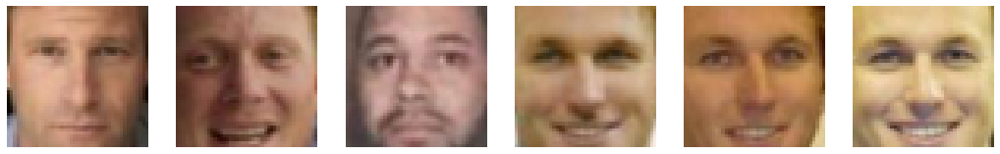

In [ ]:
plt.figure(figsize=(18, 6))
for i in range(6):
    plt.subplot(2, 6, i+1)
    plt.axis("off")
    plt.imshow(data[i])
plt.show();

In [ ]:
data_val = torch.Tensor(data[val])
data = torch.Tensor(data[tr])
data.shape, data_val.shape

(torch.Size([11172, 45, 45, 3]), torch.Size([1971, 45, 45, 3]))

In [ ]:
torch.flatten(data, start_dim=1).shape

torch.Size([11172, 6075])

In [ ]:
test = torch.flatten( data[:100], start_dim=1)
test.view( (-1, 45, 45, 3) ).shape

torch.Size([100, 45, 45, 3])

## Autoencoder
В этом разделе мы напишем и обучем обычный автоэнкодер.

Надеюсь, что к этому моменту вы уже почитали про автоэнкодеры и знаете, зачем они нужны и какова их архитектура. Если нет, то начните с этих ссылок: 

https://habr.com/ru/post/331382/ \\
https://towardsdatascience.com\intuitively-understanding-variational-autoencoders-1bfe67eb5daf



<img src="https://i.imgur.com/nVJAtMT.png" alt="Autoencoder">

^ вот так выглядит автоэнкодер

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


In [ ]:
dim_code = 64 # выберите размер латентного вектора, т.е. code, самой "узкой" части автоэнкодера

Реализуем autoencoder. Архитектуру (conv, fully-connected, ReLu, etc) можете выбирать сами. Экспериментируйте!

In [ ]:
from copy import deepcopy

class Autoencoder(nn.Module):
    def __init__(self):
      super().__init__()
      self.encoder = nn.Sequential( 
          nn.Flatten(start_dim=1),
          nn.Linear(6075, dim_code*8), nn.LeakyReLU(),
          nn.Linear(dim_code*8, dim_code*4), nn.LeakyReLU(),
          nn.Linear(dim_code*4, dim_code)
      )

      self.decoder = nn.Sequential( 
          nn.Linear(dim_code, dim_code*4), nn.LeakyReLU(),
          nn.Linear(dim_code*4, dim_code*8), nn.LeakyReLU(),
          nn.Linear(dim_code*8, 6075), nn.Sigmoid()
      )
        
    def forward(self, x):
        latent_code = self.encoder(x)
        #print( latent_code.shape )
        reconstruction = self.decoder( latent_code ).view( (-1, 45, 45, 3) )
        #print( reconstruction.shape )
        return reconstruction, latent_code

In [ ]:
criterion = nn.BCELoss().to(device)

autoencoder = Autoencoder().to(device)

optimizer = torch.optim.Adam(autoencoder.parameters(), 0.0003)

In [ ]:
torchsummary.summary(autoencoder, (45, 45, 3) )

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
           Flatten-1                 [-1, 6075]               0
            Linear-2                  [-1, 512]       3,110,912
         LeakyReLU-3                  [-1, 512]               0
            Linear-4                  [-1, 256]         131,328
         LeakyReLU-5                  [-1, 256]               0
            Linear-6                   [-1, 64]          16,448
            Linear-7                  [-1, 256]          16,640
         LeakyReLU-8                  [-1, 256]               0
            Linear-9                  [-1, 512]         131,584
        LeakyReLU-10                  [-1, 512]               0
           Linear-11                 [-1, 6075]       3,116,475
          Sigmoid-12                 [-1, 6075]               0
Total params: 6,523,387
Trainable params: 6,523,387
Non-trainable params: 0
---------------------------

In [ ]:
data.shape

torch.Size([11172, 45, 45, 3])

Осталось написать код обучения автоэнкодера. При этом было бы неплохо в процессе иногда смотреть, как автоэнкодер реконструирует изображения на данном этапе обучения. Наример, после каждой эпохи (прогона train выборки через автоэекодер) можно смотреть, какие реконструкции получились для каких-то изображений val выборки.

А, ну еще было бы неплохо выводить графики train и val лоссов в процессе тренировки =)

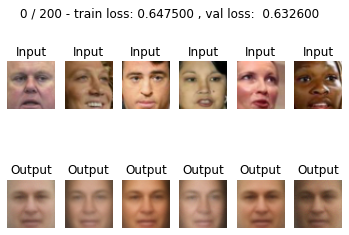

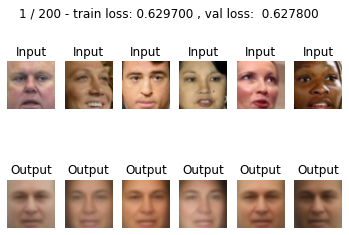

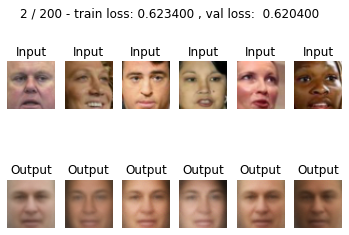

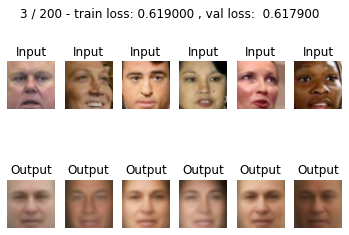

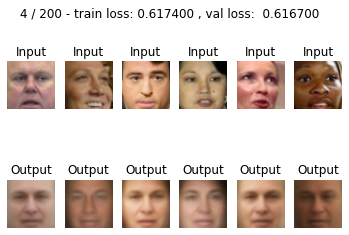

...

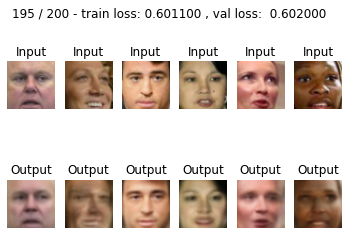

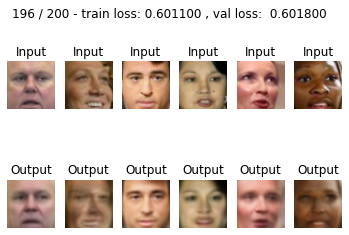

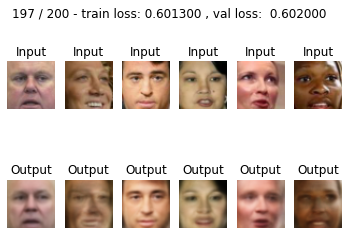

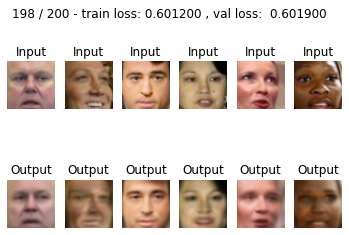

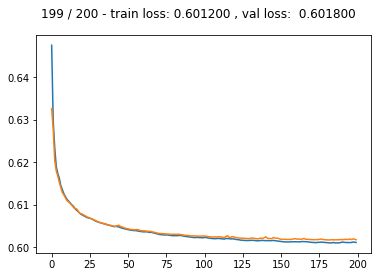

In [ ]:
#<тут Ваш код тренировки автоэнкодера>
tr_res = []
val_res = []

batch_size = 64
batch_size_1 = 32

for epoch in range(200):
  epoch_err = []
  autoencoder.train()
  for i in range( floor( len(data) / batch_size ) ):
    optimizer.zero_grad()
    input = data[ i * batch_size : (i + 1) * batch_size ].to(device)
    output = autoencoder(input)[0]
    #print( input.shape)
    #print(output.shape )
    err = criterion(output, input)
    err.backward()
    optimizer.step()
    epoch_err.append(err.detach().cpu().numpy() )
  tr_res.append( np.mean(epoch_err)  )

  val_epoch_err = []
  autoencoder.eval()
  with torch.no_grad():
    for i in range( floor( len(data_val) / batch_size_1 ) ):
      input = data_val[ i * batch_size_1 : (i + 1) * batch_size_1 ].to(device)
      output = autoencoder(input)[0]
      err = criterion(output, input)
      val_epoch_err.append(err.detach().cpu().numpy() )
    val_res.append( np.mean( val_epoch_err) )

  clear_output(wait=True)

  if epoch % 10 != 9:
    for k in range(6):
      plt.subplot(2, 6, k+1)
      plt.imshow(data_val[k].numpy() )
      plt.title('Input')
      plt.axis('off')

      plt.subplot(2, 6, k+7)
      test = data_val[k].to(device)
      #print(test.shape)
      test = autoencoder( test.view( (-1, 45, 45, 3) ) )[0].detach().cpu().numpy()
      #print(test.shape)
      plt.imshow(test[0])
      plt.title('Output')
      plt.axis('off')
    plt.suptitle('%d / %d - train loss: %f , val loss:  %f' % (epoch, 200, round(tr_res[-1], 4), round(val_res[-1], 4)  ))
  else:
    plt.plot(tr_res)
    plt.plot(val_res)
    plt.suptitle('%d / %d - train loss: %f , val loss:  %f' % (epoch, 200, round(tr_res[-1], 4), round(val_res[-1], 4)  ))

  plt.show()

Давайте посмотрим, как наш тренированный автоэекодер кодирует и восстанавливает картинки:

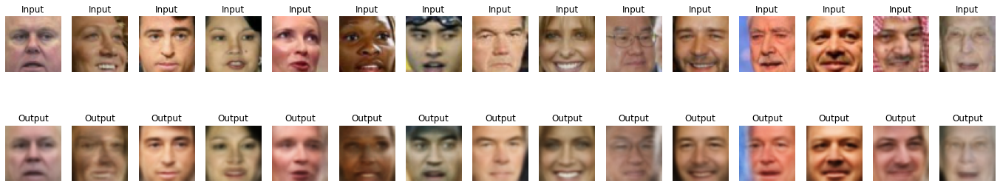

In [ ]:
#< тут Ваш код: выведите первые Х картинок и их реконструкций из val выборки на экран>
plt.figure(figsize=(24, 5))
for k in range(15):
  plt.subplot(2, 15, k+1)
  plt.imshow(data_val[k].numpy() )
  plt.title('Input')
  plt.axis('off')

  plt.subplot(2, 15, k+16)
  test = data_val[k].to(device)
  #print(test.shape)
  test = autoencoder( test.view( (-1, 45, 45, 3) ) )[0].detach().cpu().numpy()
  #print(test.shape)
  plt.imshow(test[0])
  plt.title('Output')
  plt.axis('off')

Not bad, right? 

## Sampling

Давайте теперь будем не просто брать картинку, прогонять ее через автоэекодер и получать реконструкцию, а попробуем создать что-то НОВОЕ

Давайте возьмем и подсунем декодеру какие-нибудь сгенерированные нами векторы (например, из нормального распределения) и посмотрим на результат реконструкции декодера:

#### If that doesn't work
Если вместо лиц у вас выводится непонятно что, попробуйте посмотреть, как выглядят латентные векторы картинок из датасета. Так как в обучении нейронных сетей есть определенная доля рандома, векторы латентного слоя могут быть распределены НЕ как np.random.randn(25, <latent_space_dim>). А чтобы у нас получались лица при запихивании вектора декодеру, вектор должен быть распределен так же, как лаьентные векторы реальных фоток. Так что ридется рандом подогнать.

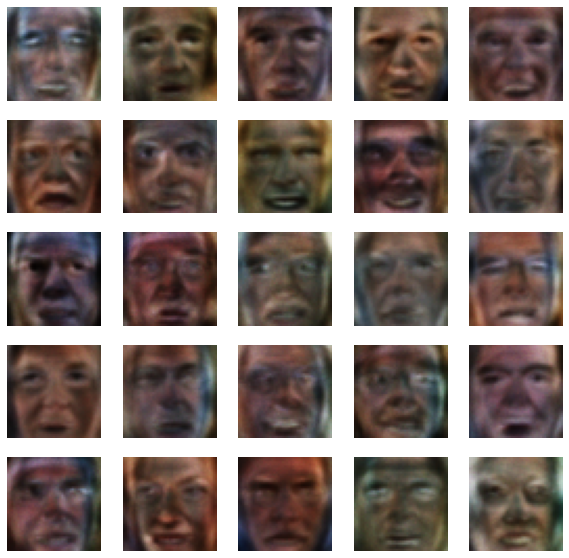

In [ ]:
# сгенерируем 25 рандомных векторов размера latent_space
z = np.random.randn(25, dim_code)
output = autoencoder.decoder(torch.Tensor(z).to(device)) #<скормите z декодеру>
#<выведите тут полученные картинки>
output = output.view(-1, 45, 45, 3)
output = output.detach().cpu().numpy()

plt.figure(figsize=(10, 10))
for k in range(5):
  for j in range(5):
    plt.subplot(5, 5, k*5 + j + 1)
    plt.imshow(output[k*5 + j] )
    plt.axis('off')

Очертания лиц хорошо видны, но раскраска жутковатая. Посмотрим распределения

In [ ]:
TOTAL = []
for i in range( floor(len(data_val) / batch_size_1 ) ):
  input = data_val[ i * batch_size_1 : (i + 1) * batch_size_1 ].to(device)
  output = autoencoder.encoder(input).detach().cpu().numpy()
  TOTAL.append(output)
len(TOTAL)

61

In [ ]:
a = np.concatenate(TOTAL)
a.shape

(1952, 64)

In [ ]:
t = pd.DataFrame(a).describe()
t

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63
count,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000,1952.000000
mean,1.709439,0.102184,-1.133042,0.197756,0.748290,1.047842,-0.133318,0.652255,0.410226,0.052218,-0.586101,3.154431,-0.096244,0.007910,-0.027463,-0.959769,-0.693551,1.030350,0.013115,-0.909091,2.013116,0.056534,2.251235,1.964448,-0.064926,-0.136179,0.094570,0.005932,-0.067095,-1.166945,-0.429825,1.011311,0.071709,0.201019,0.022007,-1.478018,-1.970279,-0.069877,0.096588,-0.168636,0.094528,-0.928378,2.141092,-0.055034,-0.129074,-0.041901,-1.134560,-0.270850,-0.028090,0.192132,1.458712,-1.599302,-0.120517,0.641667,0.108069,-0.173412,0.446533,-1.397034,-0.207719,0.128423,0.332248,-0.011545,-0.949079,1.789824
std,0.617502,0.509883,0.660536,0.488802,0.582229,0.560291,0.531124,0.624804,0.539772,0.597196,0.650240,0.661189,0.635547,0.842766,0.580663,0.650172,0.658600,0.625813,0.577418,0.631278,0.663228,0.619868,0.679162,0.624281,0.615709,0.681173,0.534849,0.513661,0.663562,0.681613,0.597835,0.554053,0.593043,0.589222,0.623026,0.600897,1.047504,0.569899,0.579662,0.507842,0.631688,0.747991,0.599992,0.481135,0.629464,0.563333,0.634179,0.594747,0.469555,0.620670,0.704316,0.645911,0.651684,0.554079,0.551627,0.664192,0.605221,0.613443,0.706329,0.618081,0.523384,0.558138,0.609540,0.805848
min,-0.300052,-2.459358,-4.447923,-1.944105,-1.396961,-1.219710,-2.018979,-1.925227,-1.370491,-2.096138,-4.027296,0.778148,-3.032182,-4.119107,-3.288422,-3.792179,-3.382247,-1.814890,-2.372670,-3.178988,-0.252501,-3.212729,-0.682776,-0.081573,-3.056279,-3.112883,-1.950629,-1.722810,-3.057201,-3.733568,-3.789645,-1.388202,-1.926330,-1.993573,-2.665679,-4.091228,-5.850582,-2.169276,-1.915529,-2.689234,-2.155480,-6.829388,0.231636,-2.111623,-2.388918,-2.668102,-4.516198,-4.581810,-1.965667,-1.600983,-0.542105,-3.569729,-2.823331,-0.987378,-1.986130,-3.729722,-2.325160,-3.339368,-3.064090,-1.875988,-1.602359,-3.262085,-3.251775,-1.831901
25%,1.289730,-0.193060,-1.500469,-0.115784,0.358525,0.674519,-0.468206,0.262286,0.064562,-0.349448,-0.975424,2.691573,-0.493309,-0.492386,-0.366159,-1.339273,-1.091999,0.612865,-0.358148,-1.306099,1.570711,-0.295983,1.792145,1.560219,-0.436510,-0.522911,-0.259307,-0.331521,-0.471697,-1.614382,-0.815028,0.647591,-0.319732,-0.177633,-0.373862,-1.857718,-2.623599,-0.428150,-0.275371,-0.455903,-0.296903,-1.413704,1.739294,-0.357748,-0.500931,-0.377087,-1.541499,-0.622030,-0.317028,-0.228140,0.982762,-2.041481,-0.558746,0.276369,-0.234784,-0.560255,0.074513,-1.795685,-0.651694,-0.265503,0.000465,-0.331927,-1.365451,1.292524
50%,1.671139,0.095556,-1.081695,0.195350,0.716314,1.047068,-0.133392,0.634557,0.382958,0.058313,-0.585669,3.166631,-0.092262,0.025585,-0.012363,-0.892134,-0.668543,1.007002,0.016823,-0.939245,1.999901,0.110478,2.264878,1.971956,-0.050609,-0.095719,0.099608,-0.030208,-0.067690,-1.172093,-0.423311,0.992940,0.046677,0.202432,0.029039,-1.451966,-1.950322,-0.113115,0.082285,-0.136002,0.112807,-0.888666,2.126505,-0.053469,-0.091049,-0.016946,-1.117402,-0.247748,-0.035540,0.123236,1.401220,-1.638712,-0.147303,0.602176,0.108551,-0.135385,0.452775,-1.402751,-0.197989,0.097755,0.338398

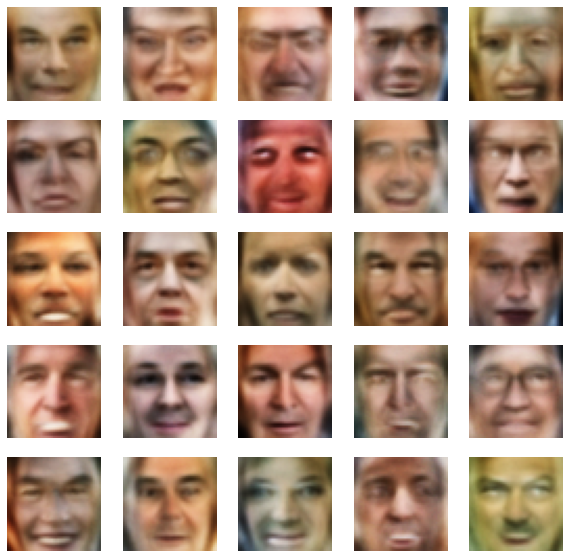

In [ ]:
# сгенерируем 25 рандомных векторов размера latent_space
z = np.random.normal(t.loc['mean'], t.loc['std'], (25, 64))
output = autoencoder.decoder(torch.Tensor(z).to(device)) #<скормите z декодеру>
#<выведите тут полученные картинки>
output = output.view(-1, 45, 45, 3)
output = output.detach().cpu().numpy()

plt.figure(figsize=(10, 10))
for k in range(5):
  for j in range(5):
    plt.subplot(5, 5, k*5 + j + 1)
    plt.imshow(output[k*5 + j] )
    plt.axis('off')

## Congrats!

Time to make fun!

Давайте научимся пририсовывать людям улыбки =)

<img src="https://i.imgur.com/tOE9rDK.png" alt="linear" width="700" height="400">

План такой:

1) Нужно выделить "вектор улыбки": для этого нужно из выборки изображений найти несколько (~15 сойдет) людей с улыбками и столько же без.

Найти людей с улыбками вам поможет файл с описанием датасета, скачанный вместе с датасетом. В нем указаны имена картинок и присутствубщие атрибуты (улыбки, очки...)

2) Вычислить латентный вектор для всех улыбающихся людей (прогнать их через encoder) и то же для всех грустненьких

3) Вычислить, собственно, вектор улыбки -- посчитать разность между средним латентным вектором улыбающихся людей и средним латентным вектором грустных людей

3) А теперь приделаем улыбку грустному человеку: добавим полученный в пункте 3 вектор к латентному вектору грустного чувака и прогоним полученный вектор через decoder. Получим того же человека, но уже не грустненького!

In [ ]:
#<а вот тут все это надо запрогать, да>
attr_tr = attrs.loc[tr].copy()
attr_tr = attr_tr.reset_index()

Выведем людей с улыбками и без

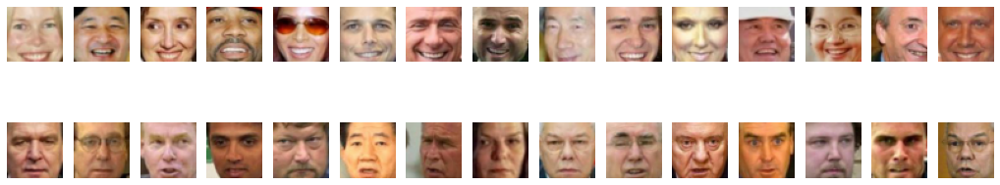

In [ ]:
ind_ = attr_tr[attr_tr.Smiling.astype(float) > 1].sample(15).index
ind_2 = attr_tr[attr_tr.Smiling.astype(float) < -1].sample(15).index

plt.figure(figsize=(18, 4))
for i in range(15):
    plt.subplot(2, 15, i+1)
    plt.axis("off")
    plt.imshow(data[ind_[i]])

    plt.subplot(2, 15, i+16)
    plt.axis("off")
    plt.imshow(data[ind_2[i]])
plt.show();

In [ ]:
np.where(tr == 0)

(array([2095]),)

Посчитаем разницу

In [ ]:
ind_ = attr_tr[attr_tr.Smiling.astype(float) > 1].index

TOTAL = []
for i in range( floor(len(ind_) / batch_size_1 ) ):
  input = data[ ind_[i * batch_size_1 : (i + 1) * batch_size_1] ].to(device)
  output = autoencoder.encoder(input).detach().cpu().numpy()
  TOTAL.append(output)
TOTAL = np.concatenate(TOTAL)
TOTAL.shape

(2240, 64)

In [ ]:
ind_2 = attr_tr[attr_tr.Smiling.astype(float) < -1].index

TOTAL2 = []
for i in range( floor(len(ind_2) / batch_size_1 ) ):
  input = data[ ind_2[i * batch_size_1 : (i + 1) * batch_size_1] ].to(device)
  output = autoencoder.encoder(input).detach().cpu().numpy()
  TOTAL2.append(output)
TOTAL2 = np.concatenate(TOTAL2)
TOTAL2.shape

(3072, 64)

In [ ]:
a = np.mean(TOTAL, axis = 0) - np.mean(TOTAL2, axis = 0)
a.shape

(64,)

Делаем улыбки

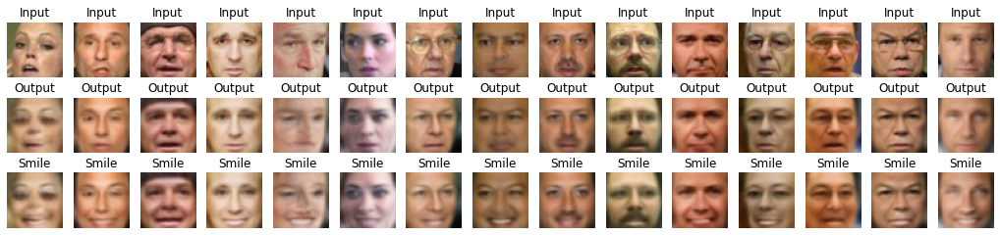

In [ ]:
ind_2 = attr_tr[attr_tr.Smiling.astype(float) < -1].sample(15).index
ind_2 = list(ind_2)
ind_2[-1] = 2095

plt.figure(figsize=(18, 4))
for i in range(15):
    plt.subplot(3, 15, i+1)
    plt.axis("off")
    plt.imshow(data[ind_2[i]])
    plt.title('Input')

    t = autoencoder.encoder( data[ind_2[i]].to(device).view( (-1, 45, 45, 3) ) )

    plt.subplot(3, 15, i+16)
    plt.axis("off")
    plt.imshow( autoencoder.decoder( t ).detach().cpu().numpy().reshape( (45, 45, 3) ))
    plt.title('Output')


    t = t + torch.Tensor(a).to(device)
    smile = autoencoder.decoder( t ).detach().cpu().numpy()

    plt.subplot(3, 15, i+31)
    plt.axis("off")
    plt.imshow( smile.reshape( (45, 45, 3) ) )
    plt.title('Smile')
plt.show();

Вуаля! Вы восхитительны!

Теперь вы можете пририсовывать людям не только улыбки, но и много чего другого -- закрывать/открывать глаза, пририсовывать очки... в общем, все, на что хватит фантазии и на что есть атрибуты в lwf_deepfinetuned.txt =)

# Variational Autoencoder. (3 балла) 

Представляю вам проапгрейдженную версию автоэнкодеров -- вариационные автоэнкодеры.

https://towardsdatascience.com/intuitively-understanding-variational-autoencoders-1bfe67eb5daf

In [ ]:
dim_code = 49

In [ ]:
class VAE(nn.Module):
    def __init__(self):
        # <определите архитектуры encoder и decoder
        # помните, у encoder должны быть два "хвоста", 
        # т.е. encoder должен кодировать картинку в 2 переменные -- mu и logsigma>
      super().__init__()
      self.encoder = nn.Sequential( 
          nn.Flatten(start_dim=1),
          nn.Linear(28*28*1, 256), nn.LeakyReLU(), nn.BatchNorm1d(256), nn.Dropout(0.3, inplace=True),
          nn.Linear(256, 128), nn.LeakyReLU(), nn.BatchNorm1d(128), nn.Dropout(0.3, inplace=True),
          #nn.Linear(dim_code*4, dim_code)
      )
      self.create_mu = nn.Linear(128, dim_code)
      self.create_sigma = nn.Linear(128, dim_code)
      self.decoder = nn.Sequential( 
          nn.Linear(dim_code, 128), nn.LeakyReLU(), nn.BatchNorm1d(128), nn.Dropout(0.3, inplace=True),
          nn.Linear(128, 256), nn.LeakyReLU(), nn.BatchNorm1d(256), nn.Dropout(0.3, inplace=True),
          nn.Linear(256, 28*28*1), nn.Sigmoid()
      )

    def encode(self, x):
        # <реализуйте forward проход энкодера
        # в качестве ваозвращаемых переменных -- mu и logsigma>
        y = self.encoder(x)
        mu = self.create_mu(y)
        logsigma = self.create_sigma(y)
        return mu, logsigma
    
    def gaussian_sampler(self, mu, logsigma):
        if self.training:
            # <засемплируйте латентный вектор из нормального распределения с параметрами mu и sigma>
            #z = torch.normal(0, 1, size=(dim_code))
            z = torch.normal(torch.zeros(dim_code), torch.ones(dim_code)).to(device)
            z = z * torch.exp(logsigma) + mu
            return z
        else:
            # на инференсе возвращаем не случайный вектор из нормального распределения, а центральный -- mu. 
            # на инференсе выход автоэнкодера должен быть детерминирован.
            return mu
    
    def decode(self, z):
        # <реализуйте forward проход декодера
        # в качестве ваозвращаемой переменной -- reconstruction>
        reconstruction = self.decoder( z ).view( (-1, 1, 28, 28) )        
        return reconstruction

    def forward(self, x):
        # <используя encode и decode, реализуйте forward проход автоэнкодера
        # в качестве ваозвращаемых переменных -- mu, logsigma и reconstruction>
        mu, logsigma = self.encode(x)

        z = self.gaussian_sampler(mu, logsigma)
        
        reconstruction = self.decode( z ) #.view( (-1, 1, 28, 28) )
        return mu, logsigma, reconstruction

Определим лосс и его компоненты для VAE:

Надеюсь, вы уже прочитали материал в towardsdatascience (или еще где-то) про VAE и знаете, что лосс у VAE состоит из двух частей: KL и log-likelihood.

Общий лосс будет выглядеть так:

$$\mathcal{L} = -D_{KL}(q_{\phi}(z|x)||p(z)) + \log p_{\theta}(x|z)$$

Формула для KL-дивергенции:

$$D_{KL} = -\frac{1}{2}\sum_{i=1}^{dimZ}(1+log(\sigma_i^2)-\mu_i^2-\sigma_i^2)$$

В качестве log-likelihood возьмем привычную нам кросс-энтропию.

In [ ]:
_BCE = nn.BCELoss()

def KL_divergence(mu, logsigma):
    """
    часть функции потерь, которая отвечает за "близость" латентных представлений разных людей
    """
    loss = torch.square( torch.exp(logsigma) ) + torch.square( mu ) - 2*logsigma - 1
    #print(loss)
    #print('We are into div error, shapes are', mu.shape, logsigma.shape, loss.shape, end = '; ')
    loss = 0.5 * torch.mean( torch.sum(loss, 1) ) #<напишите код для KL-дивергенции, пользуясь формулой выше>
    #print(loss.shape)
    return loss

def log_likelihood(x, reconstruction):
    """
    часть функции потерь, которая отвечает за качество реконструкции (как mse в обычном autoencoder)
    """
    loss = _BCE(reconstruction, x) #<binary cross-entropy>
    #print('We are into like error, shapes are', x.shape, reconstruction.shape, loss.shape, loss)
    return loss

def loss_vae(x, mu, logsigma, reconstruction):
    a = log_likelihood(x, reconstruction)
    b = KL_divergence(mu, logsigma)
    if np.random.randint(500) == 25:
      print('likelihood error: ', a, '; divergence: ', b)
    return a + b #<соедините тут две компоненты лосса. Mind the sign!>

И обучим модель:

test code

In [ ]:
# class Autoencoder(nn.Module):
#     def __init__(self):
#       super().__init__()
#       self.encoder = nn.Sequential( 
#           nn.Flatten(start_dim=1),
#           nn.Linear(28*28, dim_code*8), nn.LeakyReLU(),
#           nn.Linear(dim_code*8, dim_code*4), nn.LeakyReLU(),
#           nn.Linear(dim_code*4, dim_code)
#       )

#       self.decoder = nn.Sequential( 
#           nn.Linear(dim_code, dim_code*4), nn.LeakyReLU(),
#           nn.Linear(dim_code*4, dim_code*8), nn.LeakyReLU(),
#           nn.Linear(dim_code*8, 28*28), nn.Sigmoid()
#       )
        
#     def forward(self, x):
#         latent_code = self.encoder(x)
#         #print( latent_code.shape )
#         reconstruction = self.decoder( latent_code ).view( (-1, 1, 28, 28) )
#         #print( reconstruction.shape )
#         return reconstruction, latent_code

In [ ]:
# criterion = nn.BCELoss().to(device)

In [ ]:
# _BCE = nn.BCELoss()

# def log_likelihood(reconstruction, x):
#     """
#     часть функции потерь, которая отвечает за качество реконструкции (как mse в обычном autoencoder)
#     """
#     loss = _BCE(reconstruction, x) #<binary cross-entropy>
#     #print('We are into like error, shapes are', x.shape, reconstruction.shape, loss.shape, loss)
#     return loss

# criterion = log_likelihood

In [ ]:
criterion = loss_vae

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


In [ ]:
#autoencoder = Autoencoder().to(device) #
autoencoder = VAE().to(device)

In [ ]:
optimizer = torch.optim.Adam(autoencoder.parameters(), 0.0001) #<Ваш любимый оптимизатор>
#optimizer = torch.optim.Adam(autoencoder.parameters(), 0.0001*0.065) 

In [ ]:
torchsummary.summary(autoencoder, (1, 28, 28) )

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
           Flatten-1                  [-1, 784]               0
            Linear-2                  [-1, 256]         200,960
         LeakyReLU-3                  [-1, 256]               0
       BatchNorm1d-4                  [-1, 256]             512
           Dropout-5                  [-1, 256]               0
            Linear-6                  [-1, 128]          32,896
         LeakyReLU-7                  [-1, 128]               0
       BatchNorm1d-8                  [-1, 128]             256
           Dropout-9                  [-1, 128]               0
           Linear-10                   [-1, 49]           6,321
           Linear-11                   [-1, 49]           6,321
           Linear-12                  [-1, 128]           6,400
        LeakyReLU-13                  [-1, 128]               0
      BatchNorm1d-14                  [

MNIST

In [ ]:
# скопирнул загрузку с https://nextjournal.com/gkoehler/pytorch-mnist

batch_size = 64
batch_size_1 = 64

train_loader = torch.utils.data.DataLoader(
  torchvision.datasets.MNIST('/files/', train=True, download=True,
                             transform=torchvision.transforms.Compose([
                               torchvision.transforms.ToTensor(),
                               #torchvision.transforms.Normalize((0.1307,), (0.3081,))
                             ])),
  batch_size=batch_size, shuffle=True)

test_loader = torch.utils.data.DataLoader(
  torchvision.datasets.MNIST('/files/', train=False, download=True,
                             transform=torchvision.transforms.Compose([
                               torchvision.transforms.ToTensor(),
                               #torchvision.transforms.Normalize((0.1307,), (0.3081,))
                             ])),
  batch_size=batch_size_1, shuffle=True)

Extracting /files/MNIST/raw/train-images-idx3-ubyte.gz to /files/MNIST/raw



Extracting /files/MNIST/raw/train-labels-idx1-ubyte.gz to /files/MNIST/raw


Extracting /files/MNIST/raw/t10k-images-idx3-ubyte.gz to /files/MNIST/raw


Extracting /files/MNIST/raw/t10k-labels-idx1-ubyte.gz to /files/MNIST/raw
Processing...
Done!


/usr/local/lib/python3.6/dist-packages/torchvision/datasets/mnist.py:480: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:141.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


In [ ]:
examples = enumerate(test_loader)
batch_idx, (example_data, example_targets) = next(examples)

In [ ]:
example_data.shape

torch.Size([64, 1, 28, 28])

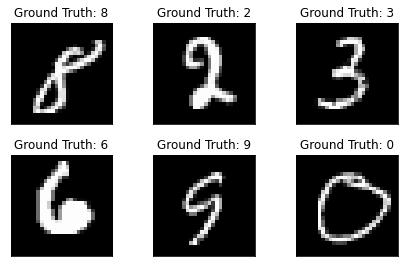

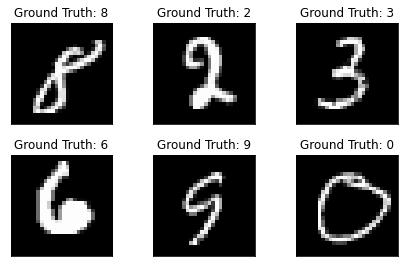

In [ ]:
import matplotlib.pyplot as plt

fig = plt.figure()
for i in range(6):
  plt.subplot(2,3,i+1)
  plt.tight_layout()
  plt.imshow(example_data[i][0], cmap='gray', interpolation='none')
  plt.title("Ground Truth: {}".format(example_targets[i]))
  plt.xticks([])
  plt.yticks([])
fig

(1, 1, 28, 28)
(1, 1, 28, 28)
(1, 1, 28, 28)
(1, 1, 28, 28)
(1, 1, 28, 28)
(1, 1, 28, 28)


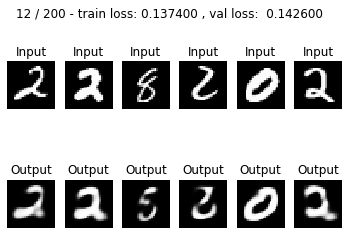

likelihood error:  tensor(0.1321, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>) ; divergence:  tensor(0.0009, device='cuda:0', grad_fn=<DivBackward0>)


KeyboardInterrupt: ignored

In [ ]:
#<обучите модель, как и autoencoder, но на датасете MNIST>
def loss_vae(x, mu, logsigma, reconstruction):
    a = log_likelihood(x, reconstruction)
    b = KL_divergence(mu, logsigma) / 1500
    if np.random.randint(500) == 25:
      print('likelihood error: ', a, '; divergence: ', b)
    return a + b #<соедините тут две компоненты лосса. Mind the sign!>
criterion = loss_vae

tr_res = []
val_res = []

for epoch in range(50):

  epoch_err = []
  autoencoder.train()
  for batch_idx, (data, target) in enumerate(train_loader):
    optimizer.zero_grad()
    input = data.to(device)
    mu, logsigma, output = autoencoder(input) # mu, logsigma, reconstruction
    ###output, _latent = autoencoder(input)
    err = criterion(input, mu, logsigma, output) # (x, mu, logsigma, reconstruction)
    ###err = criterion(output, input)
    err.backward()
    optimizer.step()
    epoch_err.append(err.detach().cpu().numpy() )
  tr_res.append( np.mean(epoch_err)  )

  val_epoch_err = []
  autoencoder.eval()
  with torch.no_grad():
    for batch_idx, (data, target) in enumerate(test_loader):
      input = data.to(device)
      mu, logsigma, output = autoencoder(input)
      ###output, _latent = autoencoder(input)
      err = criterion(input, mu, logsigma, output) # (x, mu, logsigma, reconstruction)
      ###err = criterion(output, input)
      val_epoch_err.append(err.detach().cpu().numpy() )
    val_res.append( np.mean( val_epoch_err) )

  clear_output(wait=True)

  if epoch % 10 != 9:
    for k in range(6):
      plt.subplot(2, 6, k+1)
      plt.imshow(data[k][0].numpy(), cmap='gray', interpolation='none' )
      plt.title('Input')
      plt.axis('off')

      plt.subplot(2, 6, k+7)
      test = data[k].to(device)
      #print(test.shape)
      #test = autoencoder( test.view( (-1, 1, 28, 28) ) )[0].detach().cpu().numpy()
      test = autoencoder( test[0].view( (-1, 1, 28, 28) ) )[2].detach().cpu().numpy()
      print(test.shape)
      plt.imshow(test[0][0], cmap='gray', interpolation='none' ) # [0]
      plt.title('Output')
      plt.axis('off')
    plt.suptitle('%d / %d - train loss: %f , val loss:  %f' % (epoch, 200, round(tr_res[-1], 4), round(val_res[-1], 4)  ))
  else:
    plt.plot(tr_res)
    plt.plot(val_res)
    plt.suptitle('%d / %d - train loss: %f , val loss:  %f' % (epoch, 200, round(tr_res[-1], 4), round(val_res[-1], 4)  ))

  plt.show()

save

In [ ]:
PATH = "/content/gdrive/MyDrive/VAE.pt"
torch.save({
            #'epoch': epoch,
            'model_state_dict': autoencoder.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            }, PATH)

load

In [ ]:
PATH = "/content/gdrive/MyDrive/VAE.pt"

checkpoint = torch.load(PATH)
autoencoder.load_state_dict(checkpoint['model_state_dict'])
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])

next

In [ ]:
autoencoder.eval()

Давайте посмотрим, как наш тренированный VAE кодирует и восстанавливает картинки:

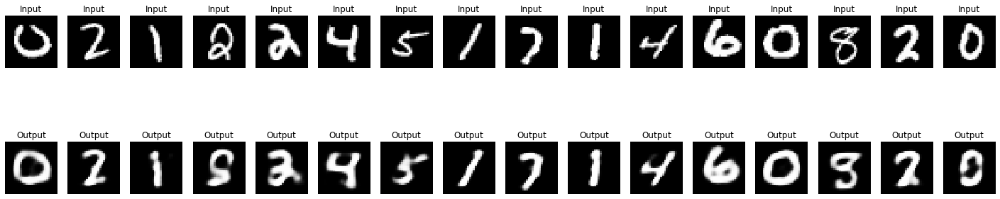

In [ ]:
#< тут Ваш код: выведите первые Х картинок и их реконструкций из val выборки на экран>
examples = enumerate(test_loader)
batch_idx, (data, example_targets) = next(examples)

_num = 16

test = data[:_num].to(device)
test = autoencoder( test )[2].detach().cpu().numpy()

plt.figure(figsize=(25, 6))

for k in range(_num):
  plt.subplot(2, _num, k+1)
  plt.imshow(data[k][0].numpy(), cmap='gray', interpolation='none' )
  plt.title('Input')
  plt.axis('off')

  plt.subplot(2, _num, k+_num+1)
  #test = data[k].to(device)
  #test = autoencoder( test.view( (-1, 1, 28, 28) ) )[0].detach().cpu().numpy()
  #test = autoencoder( test.view( (-1, 1, 28, 28) ) )[2]
  #print(test.shape)
  plt.imshow(test[k][0], cmap='gray', interpolation='none' ) # [0]
  plt.title('Output')
  plt.axis('off')


And finally sample from VAE.

## Sampling

Давайте попробуем проделать для VAE то же, что и с обычным автоэнкодером -- подсунуть decoder'у из VAE случайные векторы из нормального распределения и посмотреть, какие картинки получаются:

In [ ]:
#<ваш код получения латентных представлений, применения TSNE и визуализации>
mu_ = []
sigma_ = []
targets = []

for batch_idx, (data, target) in enumerate(test_loader):
  targets.append(target)
  input = data.to(device)
  mu, logsigma = autoencoder.encode(input)
  mu_.append(mu.detach().cpu().numpy())
  sigma_.append(logsigma.detach().cpu().numpy())

mu_ = np.concatenate(mu_)
sigma_ = np.concatenate(sigma_)
targets = np.concatenate(targets)

mu_.shape, sigma_.shape, targets.shape

((10000, 49), (10000, 49), (10000,))

In [ ]:
for arr in [mu_, sigma_]:
  print(arr.mean(), arr.min(), arr.max())

-0.009714436 -0.9347142 0.94606256
-0.022767838 -0.06048107 0.042145684


In [ ]:
#list( mu_.mean(axis = 0) )

1. Стандартное нормальное

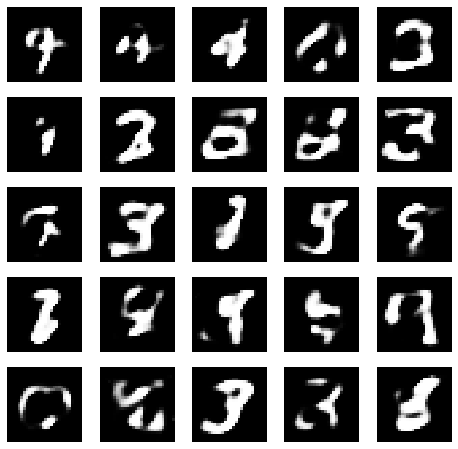

In [ ]:
z = np.array([np.random.normal(0, 1, 49) for i in range(25)])

output = autoencoder.decoder(torch.Tensor(z).to(device))
output = output.view(-1, 1, 28, 28)
output = output.detach().cpu().numpy()

plt.figure(figsize=(8, 8))
for k in range(5):
  for j in range(5):
    plt.subplot(5, 5, k*5 + j + 1)
    plt.imshow(output[k*5 + j][0] , cmap='gray', interpolation='none' ) 
    plt.axis('off')

2. Средние значения

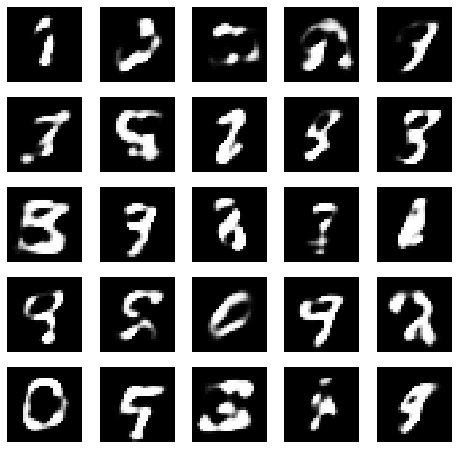

In [ ]:
# вспомните про замечание из этого же пункта обычного AE про распределение латентных переменных
# z = np.array([np.random.normal(0, 1, 49) for i in range(25)])
z = np.array( [
               np.random.normal(mu_.mean(axis = 0), np.exp( sigma_.mean(axis = 0) ) ) for i in range(25)
               ])

output = autoencoder.decoder(torch.Tensor(z).to(device)) # <скормите z декодеру>
#<выведите тут полученные картинки>
output = output.view(-1, 1, 28, 28)
output = output.detach().cpu().numpy()

plt.figure(figsize=(8, 8))
for k in range(5):
  for j in range(5):
    plt.subplot(5, 5, k*5 + j + 1)
    plt.imshow(output[k*5 + j][0] , cmap='gray', interpolation='none' ) 
    plt.axis('off')

3. Облака конкретных цифр

In [ ]:
mu_.shape, sigma_.shape, targets.shape

((10000, 49), (10000, 49), (10000,))

In [ ]:
outputs = []

for i in range(10):
  a = mu_[targets == i].mean(axis = 0)
  b = np.exp( sigma_[targets == i].mean(axis = 0) )
  z = np.array( [
               np.random.normal(a, b / 4) for j in range(5)
               ])

  output = autoencoder.decoder(torch.Tensor(z).to(device)) 
  output = output.view(-1, 1, 28, 28)
  output = output.detach().cpu().numpy()
  outputs.append(output)

  # plt.figure(figsize=(8, 8))
  # for k in range(5):
  #   for j in range(5):
  #     plt.subplot(5, 5, k*5 + j + 1)
  #     plt.imshow(output[k*5 + j][0] , cmap='gray', interpolation='none' ) 
  #     plt.axis('off')

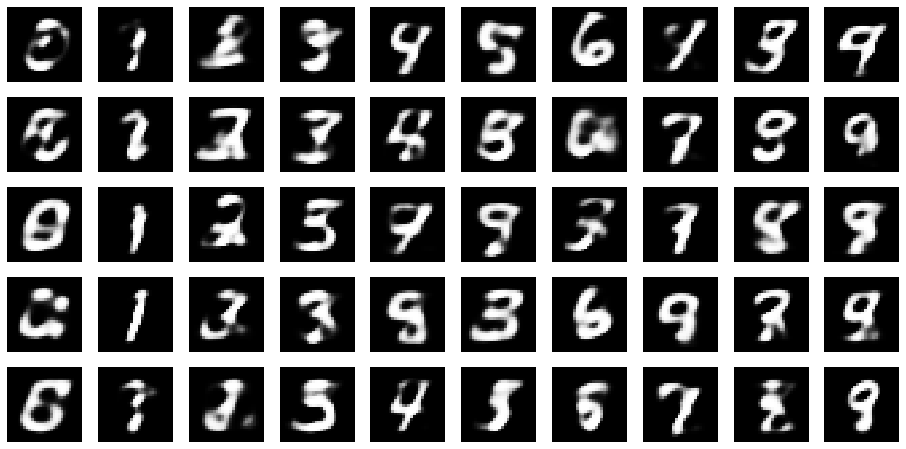

In [ ]:
plt.figure(figsize=(16, 8))
for k in range(5):
  for j in range(10):
    plt.subplot(5, 10, k*10 + j + 1)
    plt.imshow(outputs[j][k][0] , cmap='gray', interpolation='none' ) 
    plt.axis('off')

4. Сетка (взял со статьи с хабра)

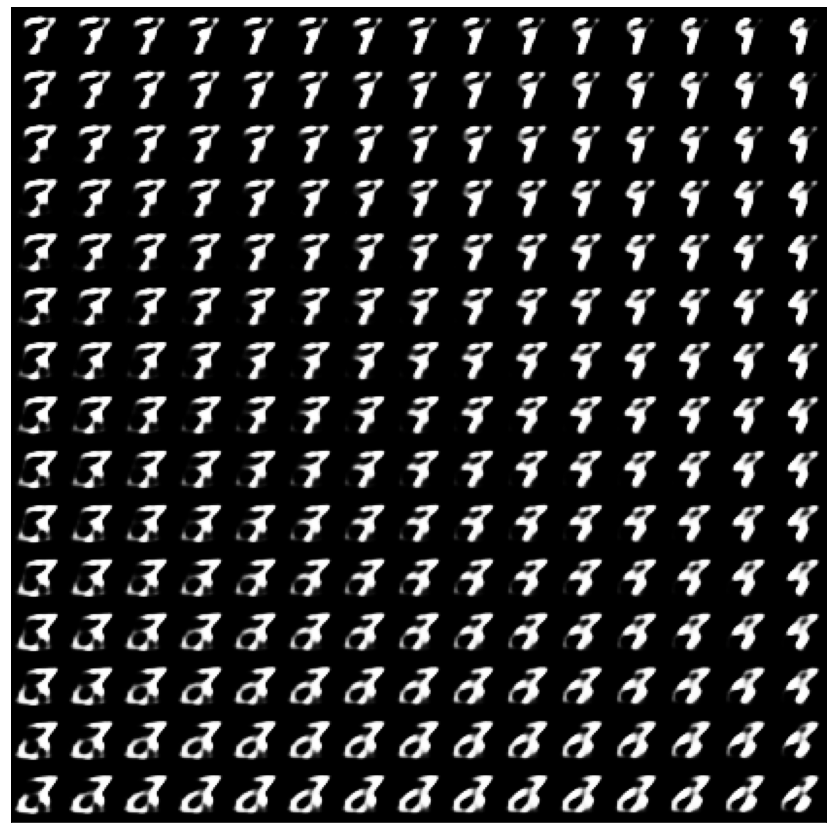

In [ ]:
n = 15 # Картинка с 15x15 цифр
digit_size = 28

grid_x = norm.ppf(np.linspace(0.05, 0.95, n))
grid_y = norm.ppf(np.linspace(0.05, 0.95, n))

figure = np.zeros((digit_size * n, digit_size * n))
for i, yi in enumerate(grid_x):
    for j, xi in enumerate(grid_y):
        z_sample = np.zeros((1, 49))
        z_sample[:, 16:18] = np.array([[xi, yi]])

        x_decoded = autoencoder.decoder( torch.Tensor(z_sample).to(device)  )
        digit = x_decoded[0].squeeze()
        figure[i * digit_size: (i + 1) * digit_size,
                j * digit_size: (j + 1) * digit_size] = digit.view(-1, 1, 28, 28).detach().cpu().numpy()
if True:
    # Визуализация
    plt.figure(figsize=(15, 15))
    plt.imshow(figure, cmap='Greys_r')
    plt.grid(None)
    ax = plt.gca()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)        
    plt.show()

## Latent Representation

Давайте посмотрим, как латентные векторы картинок лиц выглядят в пространстве.
Ваша задача -- изобразить латентные векторы картинок точками в двумерном просторанстве. 

Это позволит оценить, насколько плотно распределены латентные векторы лиц в пространстве. 

Плюс давайте сделаем такую вещь: у вас есть файл с атрибутами lwf_deepfinetuned.txt, который скачался вместе с базой картинок. Там для каждой картинки описаны атрибуты картинки (имя человека, его пол, цвет кожи и т.п.). Когда будете визуализировать точки латентного пространства на картинке, возьмите какой-нибудь атрибут и покрасьте точки в соответствии со значем атрибута, соответствующего этой точке. 

Например, возьмем атрибут "пол". Давайте покрасим точки, которые соответствуют картинкам женщин, в один цвет, а точки, которые соответствуют картинкам мужчин -- в другой.

Подсказка: красить -- это просто =) У plt.scatter есть параметр c (color), см. в документации.


Итак, план:
1. Получить латентные представления картинок тестового датасета
2. С помощтю TSNE (есть в sklearn) сжать эти представления до размерности 2 (чтобы можно было их визуализировать точками в пространстве)
3. Визуализировать полученные двумерные представления с помощью matplotlib.scatter, покрасить разными цветами точки, соответствующие картинкам с разными атрибутами.

In [ ]:
embedded = TSNE(n_components=2).fit_transform(  np.concatenate([mu_, sigma_], axis = 1)  )
embedded.shape

(10000, 2)

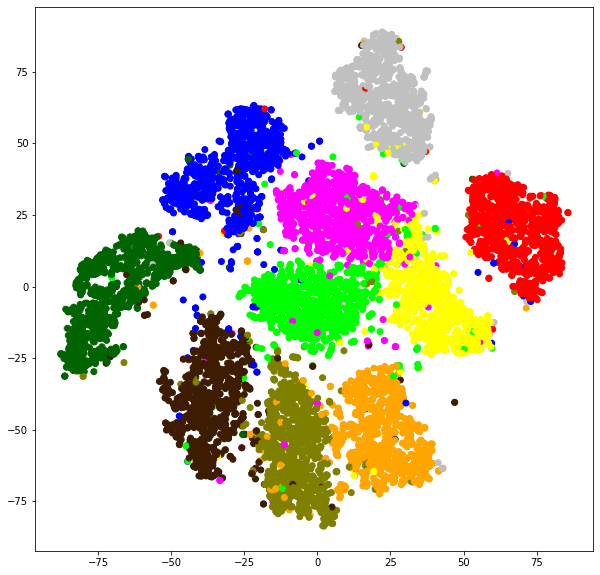

In [ ]:
plt.figure(figsize=(10, 10))

colors = ['red',
'darkgreen',
'blue',
'magenta',
'orange',
'yellow',
'silver',
'xkcd:chocolate',
'lime',
'olive'
          ]

plt.scatter(embedded[:, 0], embedded[:, 1], c = [colors[i] for i in targets]
            )

(0.0, 3.0, 0.0, 11.0)

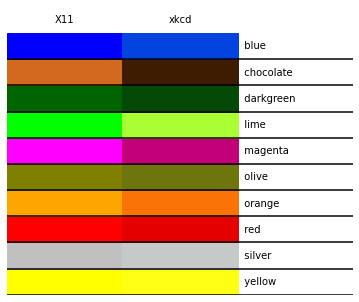

In [ ]:
# #https://matplotlib.org/tutorials/colors/colors.html
# import matplotlib._color_data as mcd
# import matplotlib.patches as mpatch

# #overlap = {name for name in mcd.CSS4_COLORS if "xkcd:" + name in mcd.XKCD_COLORS}
# overlap = {'red',
# 'darkgreen',
# 'blue',
# 'magenta',
# 'orange',
# 'yellow',
# 'silver',
# 'chocolate',
# 'lime',
# 'olive',}

# fig = plt.figure(figsize=[4.8, 4]) # plt.figure(figsize=[4.8, 16])
# ax = fig.add_axes([0, 0, 1, 1])

# for j, n in enumerate(sorted(overlap, reverse=True)):
#     weight = None
#     cn = mcd.CSS4_COLORS[n]
#     xkcd = mcd.XKCD_COLORS["xkcd:" + n].upper()
#     if cn == xkcd:
#         weight = 'bold'

#     r1 = mpatch.Rectangle((0, j), 1, 1, color=cn)
#     r2 = mpatch.Rectangle((1, j), 1, 1, color=xkcd)
#     txt = ax.text(2, j+.5, '  ' + n, va='center', fontsize=10,
#                   weight=weight)
#     ax.add_patch(r1)
#     ax.add_patch(r2)
#     ax.axhline(j, color='k')

# ax.text(.5, j + 1.5, 'X11', ha='center', va='center')
# ax.text(1.5, j + 1.5, 'xkcd', ha='center', va='center')
# ax.set_xlim(0, 3)
# ax.set_ylim(0, j + 2)
# ax.axis('off')

Что вы думаете о виде латентного представления?

**Кластеры точек хорошо различимы. Взаимное расположение кластеров представлений цифр хорошо отражает их реальное сходство.**

## Congrats v2.0!

# Conditional VAE (2 балла)


Мы уже научились обучать обычный AE на датасете картинок и получать новые картинки, используя генерацию шума и декодер. 
Давайте теперь допустим, что мы обучили AE на датасете MNIST и теперь хотим генерировать новые картинки с числами с помощью декодера (как выше мы генерили рандомные лица). 
И вот мне понадобилось сгенерировать цифру 8. И я подставляю разные варианты шума, и все никак не генерится восьмерка -- у меня получаются то пятерки, то тройки, то четверки. Гадость(

  Хотелось бы добавить к нашему AE функцию "выдай мне пожалуйста рандомное число из вот этого вот класса", где классов десять (цифры от 0 до 9 образуют десять классов).
  Типа я такая говорю "выдай мне случайную восьмерку" и оно генерит случайную восьмерку!

Conditional AE -- так называется вид автоэнкодера, который предоставляет такую возможность. Ну, название "conditional" уже говорит само за себя.

И в этой части проекта мы научимся такие обучать.

## Архитектура

На картинке ниже представлена архитектура простого Conditional AE.

По сути, единственное отличие от обычного -- это то, что мы вместе с картинкой в первом слое энкодера и декодера передаем еще информацию о классе картинки. 

То есть, в первый (входной) слой энкодера есть конкатенация картинки и информации о классе (например, вектора из девяти нулей и одной единицы). Первый слой декодера есть конкатенация латентного вектора и информации о классе.


![alt text](https://i.ibb.co/2tsWknB/Screen-Shot-2020-01-15-at-9-02-15-PM.png)



На всякий случай: это VAE, то есть, latent у него состоит из mu и sigma все еще.

Таким образом, при генерации новой рандомной картинки мы должны будем передать декодеру сконкатенированные латентный вектор и класс картинки.

### P.S.
Можно ередавать класс картинки не только в первый слой, но и в каждый слой сети. То есть на каждом слое конкатенировать выход из предыдущего слоя и информацию о классе.

### Датасет
Здесь я предлагаю вам два вариана. Один попроще, другой -- посложнее, но поинтереснее =)

1. Использовать датасет MNIST (http://yann.lecun.com/exdb/mnist/). Обучать conditional VAE на этом датасете, condition -- класс цифры. 

2. Использовать датасет лиц, с которым мы игрались выше. Condition -- пол/раса/улыбки/whatever из lfw_deepfinetuned.txt. 

Почему второй вариант "посложнее" -- потому что я сама еще не знаю, получится ли такой CVAE с лицами или нет =) Вы -- исследователи! (не ну это же проект, так и должно быть)

In [ ]:
#<тут ваш код объявления CVAE, лосса, оптимизатора и тренировки>

In [ ]:
for col in ['Male', 'White', 'Asian', 'Black', 'Indian']:
  attrs[col] = attrs[col].astype(float)
attrs['who'] = attrs[['White', 'Asian', 'Black', 'Indian']].idxmax(axis = 1)

In [ ]:
attr_tr = attrs.loc[tr].copy().reset_index()
attr_val = attrs.loc[val].copy().reset_index()
data.shape, data_val.shape, attr_tr.shape, attr_val.shape

(torch.Size([11172, 45, 45, 3]),
 torch.Size([1971, 45, 45, 3]),
 (11172, 75),
 (1971, 75))

Indian выглядит как что-то рандомное. Дропнем эти картинки, учитывая их небольшое количество

In [ ]:
ind_ = attr_tr[attr_tr.who != 'Indian'].index
attr_tr = attr_tr.loc[ind_].reset_index()
data = data[ind_]

ind_ = attr_val[attr_val.who != 'Indian'].index
attr_val = attr_val.loc[ind_].reset_index()
data_val = data_val[ind_]
data.shape, data_val.shape, attr_tr.shape, attr_val.shape

(torch.Size([10756, 45, 45, 3]),
 torch.Size([1888, 45, 45, 3]),
 (10756, 76),
 (1888, 76))

In [ ]:
attr_tr[['Male', 'White', 'Asian', 'Black', 'Indian', 'who']].sample(5)

,Male,White,Asian,Black,Indian,who
2306,1.109898,-1.621315,-0.557018,-0.088216,-1.128813,Black
10366,1.009110,-0.035388,-1.209333,-1.852191,-1.165313,White
9836,1.793690,1.167832,-1.464764,-1.899884,-1.228637,White
1547,1.964908,0.266884,-1.804752,-1.885562,-0.090767,White
7493,1.677188,-0.656308,-0.076998,-1.582196,-0.303886,Asian


In [ ]:
attr_tr.who.value_counts()

White    9092
Asian    1116
Black     548
Name: who, dtype: int64

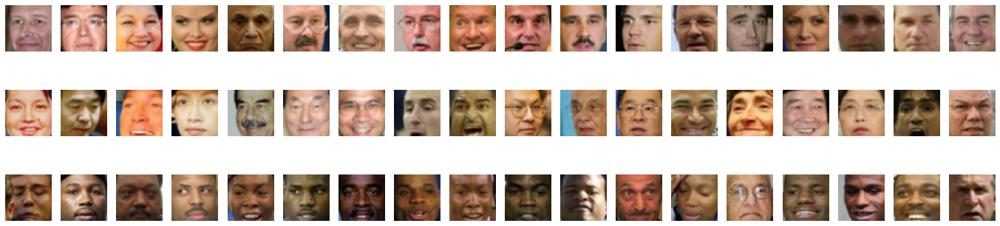

In [ ]:
plt.figure(figsize=(24, 6))

for j, attr in enumerate( ['White', 'Asian', 'Black'] ):
  ind_ = attr_tr[attr_tr.who == attr].sample(18).index
  disp = data[ ind_ ]
  for i in range(18):
      plt.subplot(3, 18, j*18 + i + 1)
      plt.axis("off")
      plt.imshow(disp[i])
plt.show();

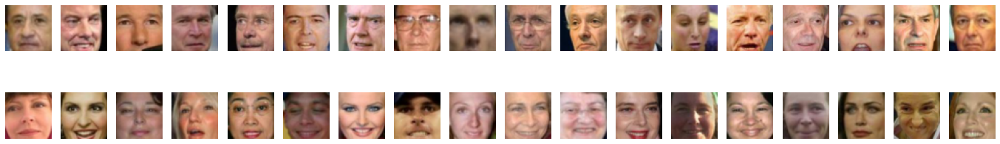

In [ ]:
plt.figure(figsize=(24, 4))

for j, coef in enumerate( [1, -1] ):
  ind_ = attr_tr[attr_tr.Male * coef > 0 ].sample(18).index
  disp = data[ ind_ ]
  for i in range(18):
      plt.subplot(2, 18, j*18 + i + 1)
      plt.axis("off")
      plt.imshow(disp[i])
plt.show();

In [ ]:
for df in [attr_tr, attr_val]:
  df['gender'] = (df.Male > 0).astype(int)
  df['race_w'] = (df.who == 'White').astype(int)
  df['race_a'] = (df.who == 'Asian').astype(int)
  df['race_b'] =(df.who == 'Black').astype(int)
  display(df.pivot_table( 'index', index = 'gender', columns = ['race_w', 'race_a', 'race_b'], aggfunc = 'count' ))

race_w    0          1
race_a    0    1     0
race_b    1    0     0
gender                
0       121  302  2013
1       427  814  7079

race_w   0          1
race_a   0    1     0
race_b   1    0     0
gender               
0       36   48   345
1       91  154  1214

Тут закомменчен upsampling, который, к сожалению, только вредит

In [ ]:
# w_coef = 2
# b_coef = 10
# a_coef = 6


# i1_ = attr_tr[attr_tr.gender == 0].index
# for j in range(w_coef - 1):
#   attr_tr = pd.concat([attr_tr, attr_tr.loc[i1_]], ignore_index = True)
#   data = np.concatenate( (data, data[i1_]), axis = 0 )

# i1_ = attr_tr[attr_tr.race_a == 1].index
# for j in range(a_coef - 1):
#   attr_tr = pd.concat([attr_tr, attr_tr.loc[i1_]], ignore_index = True)
#   data = np.concatenate( (data, data[i1_]), axis = 0 )

# i1_ = attr_tr[attr_tr.race_b == 1].index
# for j in range(b_coef - 1):
#   attr_tr = pd.concat([attr_tr, attr_tr.loc[i1_]], ignore_index = True)
#   data = np.concatenate( (data, data[i1_]), axis = 0 )


# data = torch.Tensor(data)
# data.shape, attr_tr.shape


# for df in [attr_tr]:
#   df['gender'] = (df.Male > 0).astype(int)
#   df['race_w'] = (df.who == 'White').astype(int)
#   df['race_a'] = (df.who == 'Asian').astype(int)
#   df['race_b'] =(df.who == 'Black').astype(int)
#   display(df.pivot_table( 'index', index = 'gender', columns = ['race_w', 'race_a', 'race_b'], aggfunc = 'count' ))


# a = np.array(attr_tr.index)
# np.random.shuffle( a )
# a.shape, a[:10]


# attr_tr = attr_tr.loc[a]
# attr_tr.drop(columns = ['level_0', 'index'], inplace = True)
# attr_tr = attr_tr.reset_index()

# data = data[a]
# data.shape, attr_tr.shape

Модель

In [ ]:
dim_code = 96 #64

In [ ]:
class CVAE_base(nn.Module):
    def __init__(self):
        # <определите архитектуры encoder и decoder
        # помните, у encoder должны быть два "хвоста", 
        # т.е. encoder должен кодировать картинку в 2 переменные -- mu и logsigma>
      super().__init__()
      self.flatten = nn.Flatten(start_dim=1)

      self.encoder = nn.Sequential(           
          nn.Linear(45*45*3 + 4, dim_code*8), nn.LeakyReLU(), #nn.BatchNorm1d(dim_code*8), nn.Dropout(0.3, inplace=True),
          nn.Linear(dim_code*8, dim_code*4), nn.LeakyReLU(), #nn.BatchNorm1d(dim_code*4), nn.Dropout(0.3, inplace=True)
      )
      self.create_mu = nn.Linear(dim_code*4, dim_code)
      self.create_sigma = nn.Linear(dim_code*4, dim_code)
      self.decoder = nn.Sequential( 
          nn.Linear(dim_code + 4, dim_code*4), nn.LeakyReLU(), #nn.BatchNorm1d(dim_code*4), nn.Dropout(0.3, inplace=True),
          nn.Linear(dim_code*4, dim_code*8), nn.LeakyReLU(), #nn.BatchNorm1d(dim_code*8), nn.Dropout(0.3, inplace=True),
          nn.Linear(dim_code*8, 45*45*3), nn.Sigmoid()
      )

    def encode(self, x):
        # <реализуйте forward проход энкодера
        # в качестве ваозвращаемых переменных -- mu и logsigma>
        y = self.encoder(x)
        mu = self.create_mu(y)
        logsigma = self.create_sigma(y)
        return mu, logsigma
    
    def gaussian_sampler(self, mu, logsigma):
        if self.training:
            # <засемплируйте латентный вектор из нормального распределения с параметрами mu и sigma>
            #z = torch.normal(0, 1, size=(dim_code))
            z = torch.normal(torch.zeros(dim_code), torch.ones(dim_code)).to(device)
            z = z * torch.exp(logsigma) + mu
            return z
        else:
            # на инференсе возвращаем не случайный вектор из нормального распределения, а центральный -- mu. 
            # на инференсе выход автоэнкодера должен быть детерминирован.
            return mu
    
    def decode(self, z):
        # <реализуйте forward проход декодера
        # в качестве ваозвращаемой переменной -- reconstruction>
        reconstruction = self.decoder( z ).view( (-1, 45, 45, 3) )        
        return reconstruction

    def forward(self, x, label):
        # <используя encode и decode, реализуйте forward проход автоэнкодера
        # в качестве ваозвращаемых переменных -- mu, logsigma и reconstruction>
        #print('START: ', x.shape, label.shape, end = '; ')
        x = self.flatten(x)
        #print(x.shape, end = '; ')
        x =  torch.cat(  [x, label], dim = 1 )
        #print(x.shape)

        mu, logsigma = self.encode( x )

        z = self.gaussian_sampler(mu, logsigma)
        
        reconstruction = self.decode(  torch.cat(  [z, label], dim = 1 ) ) #.view( (-1, 1, 28, 28) )
        return mu, logsigma, reconstruction

In [ ]:
class CVAE(nn.Module):
    def __init__(self):
      super().__init__()

      # ENCODER
      self.flatten = nn.Flatten(start_dim=1)
      self.encoder_0 = nn.Sequential(           
          nn.Linear(45*45*3 + 4, dim_code*8), nn.LeakyReLU(), #nn.BatchNorm1d(dim_code*8), nn.Dropout(0.3, inplace=True),
      )
      self.encoder_1 = nn.Sequential(      
          nn.Linear(dim_code*8 + 4, dim_code*4), nn.LeakyReLU(), #nn.BatchNorm1d(dim_code*4), nn.Dropout(0.3, inplace=True)
      )

      self.create_mu = nn.Linear(dim_code*4, dim_code)
      self.create_sigma = nn.Linear(dim_code*4, dim_code)

      self.decoder_0 = nn.Sequential( 
          nn.Linear(dim_code + 4, dim_code*4), nn.LeakyReLU(), #nn.BatchNorm1d(dim_code*4), nn.Dropout(0.3, inplace=True),
      )
      self.decoder_1 = nn.Sequential( 
          nn.Linear(dim_code*4+4, dim_code*8), nn.LeakyReLU(), #nn.BatchNorm1d(dim_code*8), nn.Dropout(0.3, inplace=True),
          nn.Linear(dim_code*8, 45*45*3), nn.Sigmoid()
      )

    def encode(self, x, label):
        x = self.flatten(x)
        x =  torch.cat(  [x, label], dim = 1 )

        y = self.encoder_0(x)
        y = self.encoder_1( torch.cat(  [y, label], dim = 1 )  )

        mu = self.create_mu(y)
        logsigma = self.create_sigma(y)
        return mu, logsigma
    
    def gaussian_sampler(self, mu, logsigma):
        if self.training:
            z = torch.normal(torch.zeros(dim_code), torch.ones(dim_code)).to(device)
            z = z * torch.exp(logsigma) + mu
            return z
        else:
            return mu
    
    def decode(self, z, label):
        reconstruction = self.decoder_0( torch.cat(  [z, label], dim = 1 ) ) #.view( (-1, 45, 45, 3) )  
        reconstruction = self.decoder_1( torch.cat(  [reconstruction, label], dim = 1 ) ).view( (-1, 45, 45, 3) ) 

        return reconstruction

    def forward(self, x, label):
        mu, logsigma = self.encode( x, label )

        z = self.gaussian_sampler(mu, logsigma)
        
        reconstruction = self.decode( z, label ) #.view( (-1, 1, 28, 28) )
        return mu, logsigma, reconstruction

In [ ]:
_BCE = nn.BCELoss()

def KL_divergence(mu, logsigma):
    """
    часть функции потерь, которая отвечает за "близость" латентных представлений разных людей
    """
    loss = torch.square( torch.exp(logsigma) ) + torch.square( mu ) - 2*logsigma - 1
    #print(loss)
    #print('We are into div error, shapes are', mu.shape, logsigma.shape, loss.shape, end = '; ')
    loss = 0.5 * torch.mean( torch.sum(loss, 1) ) #<напишите код для KL-дивергенции, пользуясь формулой выше>
    #print(loss.shape)
    return loss

def log_likelihood(x, reconstruction):
    """
    часть функции потерь, которая отвечает за качество реконструкции (как mse в обычном autoencoder)
    """
    loss = _BCE(reconstruction, x) #<binary cross-entropy>
    #print('We are into like error, shapes are', x.shape, reconstruction.shape, loss.shape, loss)
    return loss

def loss_vae(x, mu, logsigma, reconstruction):
    a = log_likelihood(x, reconstruction)
    b = KL_divergence(mu, logsigma)
    if np.random.randint(500) == 25:
      print('likelihood error: ', a, '; divergence: ', b)
    return a + b #<соедините тут две компоненты лосса. Mind the sign!>

In [ ]:
criterion = loss_vae

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


In [ ]:
autoencoder = CVAE().to(device)

In [ ]:
optimizer = torch.optim.Adam(autoencoder.parameters(), 0.0003) #<Ваш любимый оптимизатор>

Обучение

In [ ]:
def loss_vae(x, mu, logsigma, reconstruction):
    a = log_likelihood(x, reconstruction)
    b = KL_divergence(mu, logsigma) / (15 * 10**3)
    if np.random.randint(500) == 25:
      print('likelihood error: ', a, '; divergence: ', b)
    return a + b
criterion = loss_vae

In [ ]:
tr_res = []
val_res = []

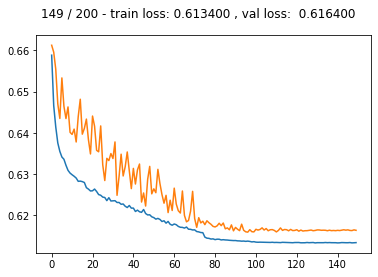

In [ ]:
batch_size = 64
batch_size_1 = batch_size

for epoch in range(150):
  if epoch == 75:
    optimizer = torch.optim.Adam(autoencoder.parameters(), 0.00003)
  elif epoch == 100:
    optimizer = torch.optim.Adam(autoencoder.parameters(), 0.000003) 
  elif epoch == 125:
    optimizer = torch.optim.Adam(autoencoder.parameters(), 0.0000003) 


  epoch_err = []
  autoencoder.train()
  for i in range( floor( len(data) / batch_size ) ):
    optimizer.zero_grad()
    input = data[ i * batch_size : (i + 1) * batch_size ]
    label = attr_tr.loc[i * batch_size : (i + 1) * batch_size - 1, ['gender', 'race_w', 'race_a', 'race_b']].reset_index()

    # Локальный апсемплинг. Тормозит обучение жутко, но мало ли что с памятью
    #print('Step 1: ', input.shape, label.shape)

    # i1_ = label[label.gender == 0].index
    # for j in range(w_coef - 1):
    #   label = pd.concat([label, label.loc[i1_]], ignore_index = True)
    #   input = np.concatenate( (input, input[i1_]), axis = 0 )

    # i1_ = label[label.race_a == 1].index
    # for j in range(a_coef - 1):
    #   label = pd.concat([label, label.loc[i1_]], ignore_index = True)
    #   input = np.concatenate( (input, input[i1_]), axis = 0 )

    # i1_ = label[label.race_b == 1].index
    # for j in range(b_coef - 1):
    #   label = pd.concat([label, label.loc[i1_]], ignore_index = True)
    #   input = np.concatenate( (input, input[i1_]), axis = 0 )

    # #print('Step 2: ', input.shape, label.shape)

    # if len(label) > batch_size * 2:
    #   i1_ = random.sample(range(len(label)), 2*batch_size)
    #   label = label.loc[i1_]
    #   input = input[i1_]
    # elif len(label) < batch_size * 2:
    #   i1_ = random.sample(range(len(label)), 2*batch_size - len(label) )
    #   input = np.concatenate( (input, input[i1_]), axis = 0 )
    #   label = pd.concat([label, label.loc[i1_]], ignore_index = True)

    #print('Step 3: ', input.shape, label.shape)

    input = input.to(device)
    label = torch.Tensor(label[['gender', 'race_w', 'race_a', 'race_b']].values).to(device)

    mu, logsigma, output = autoencoder(input, label) # + LABEL
    err = criterion(input, mu, logsigma, output)
    err.backward()
    optimizer.step()
    epoch_err.append(err.detach().cpu().numpy() )
  tr_res.append( np.mean(epoch_err)  )

  val_epoch_err = []
  autoencoder.eval()
  with torch.no_grad():
    for i in range( floor( len(data_val) / batch_size_1 ) ):
      input = data_val[ i * batch_size_1 : (i + 1) * batch_size_1 ].to(device)
      label = torch.Tensor( attr_val.loc[i * batch_size_1 : (i + 1) * batch_size_1 - 1, ['gender', 'race_w', 'race_a', 'race_b']].values ).to(device)
      mu, logsigma, output = autoencoder(input, label) # + LABEL
      err = criterion(input, mu, logsigma, output)
      val_epoch_err.append(err.detach().cpu().numpy() )
    val_res.append( np.mean( val_epoch_err) )

  clear_output(wait=True)

  if epoch % 10 != 9:
    plt.figure(figsize=(24, 4))
    for k in range(18):
      plt.subplot(2, 18, k+1)
      plt.imshow(data_val[k].numpy() )
      plt.title('Input')
      plt.axis('off')

      plt.subplot(2, 18, k+19)
      test = data_val[k].to(device)
      label = torch.Tensor( [attr_val.loc[k, ['gender', 'race_w', 'race_a', 'race_b']].values] ).to(device)
      #print(test.shape)
      mu, logsigma, test = autoencoder( test.view( (-1, 45, 45, 3) ), label ) # + LABEL
      test = test.detach().cpu().numpy()
      #print(test.shape)
      plt.imshow(test[0] )
      plt.title('Output')
      plt.axis('off')
    plt.suptitle('%d / %d - train loss: %f , val loss:  %f' % (epoch, 200, round(tr_res[-1], 4), round(val_res[-1], 4)  ))
  else:
    plt.plot(tr_res)
    plt.plot(val_res)
    plt.suptitle('%d / %d - train loss: %f , val loss:  %f' % (epoch, 200, round(tr_res[-1], 4), round(val_res[-1], 4)  ))

  plt.show()

In [ ]:
0.0018 * 20000

36.0

In [ ]:
0.0026 * 10000

26.0

In [ ]:
0.005 * 2000

10.0

save

In [ ]:
PATH = "/content/gdrive/MyDrive/CVAE_7_new.pt"
torch.save({
            #'epoch': epoch,
            'model_state_dict': autoencoder.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            }, PATH)

load

In [ ]:
PATH = "/content/gdrive/MyDrive/CVAE_7_new.pt"

checkpoint = torch.load(PATH)
autoencoder.load_state_dict(checkpoint['model_state_dict'])
#optimizer.load_state_dict(checkpoint['optimizer_state_dict'])

<All keys matched successfully>

## Sampling


Тут мы будем сэмплировать из CVAE. Это прикольнее, чем сэмплировать из простого AE/VAE: тут можно взять один и тот же латентный вектор и попросить CVAE восстановить из него картинки разных классов!
Для MNIST вы можете попросить CVAE восстановить из одного латентного вектора картинки цифры 5 и 7, а для лиц людей -- восстановить лицо улыбающегося и хмурого человека или лица людей разного пола (смотря на чем был ваш кондишен)

In [ ]:
#<тут нужно научиться сэмплировать из декодера цифры определенного класса>

In [ ]:
autoencoder.eval()

CVAE(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (encoder_0): Sequential(
    (0): Linear(in_features=6079, out_features=768, bias=True)
    (1): LeakyReLU(negative_slope=0.01)
  )
  (encoder_1): Sequential(
    (0): Linear(in_features=772, out_features=384, bias=True)
    (1): LeakyReLU(negative_slope=0.01)
  )
  (create_mu): Linear(in_features=384, out_features=96, bias=True)
  (create_sigma): Linear(in_features=384, out_features=96, bias=True)
  (decoder_0): Sequential(
    (0): Linear(in_features=100, out_features=384, bias=True)
    (1): LeakyReLU(negative_slope=0.01)
  )
  (decoder_1): Sequential(
    (0): Linear(in_features=388, out_features=768, bias=True)
    (1): LeakyReLU(negative_slope=0.01)
    (2): Linear(in_features=768, out_features=6075, bias=True)
    (3): Sigmoid()
  )
)

0. Валидация

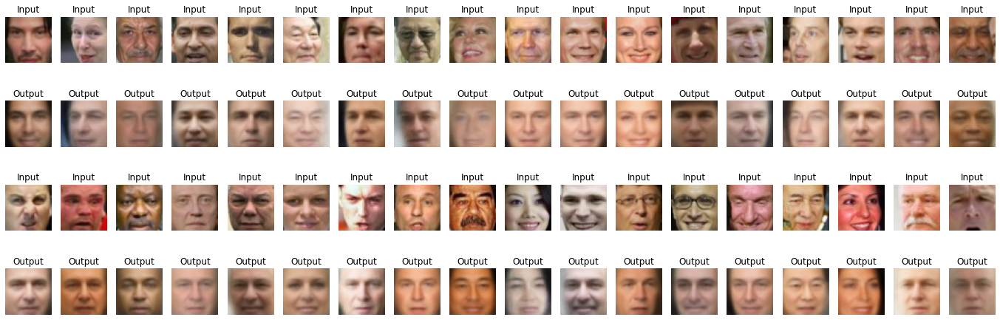

In [ ]:
plt.figure(figsize=(24, 8))
for k in range(18):
  plt.subplot(4, 18, k+1)
  plt.imshow(data_val[k].numpy() )
  #plt.imshow(data[k].numpy() )
  plt.title('Input')
  plt.axis('off')

  plt.subplot(4, 18, k+19)
  test = data_val[k].to(device)
  #test = data[k].to(device)
  label = torch.Tensor( [attr_val.loc[k, ['gender', 'race_w', 'race_a', 'race_b']].values] ).to(device)
  #label = torch.Tensor( [attr_tr.loc[k, ['gender', 'race_w', 'race_a', 'race_b']].values] ).to(device)
  #print(test.shape)
  mu, logsigma, test = autoencoder( test.view( (-1, 45, 45, 3) ), label ) # + LABEL
  test = test.detach().cpu().numpy()
  #print(test.shape)
  plt.imshow(test[0] )
  plt.title('Output')
  plt.axis('off')


  plt.subplot(4, 18, k+18*2+1)
  plt.imshow(data_val[k+18].numpy() )
  #plt.imshow(data[k+18].numpy() )
  plt.title('Input')
  plt.axis('off')

  plt.subplot(4, 18, k+18*3+1)
  test = data_val[k+18].to(device)
  #test = data[k+18].to(device)
  label = torch.Tensor( [attr_val.loc[k+18, ['gender', 'race_w', 'race_a', 'race_b']].values] ).to(device)
  #label = torch.Tensor( [attr_tr.loc[k+18, ['gender', 'race_w', 'race_a', 'race_b']].values] ).to(device)
  #print(test.shape)
  mu, logsigma, test = autoencoder( test.view( (-1, 45, 45, 3) ), label ) # + LABEL
  test = test.detach().cpu().numpy()
  #print(test.shape)
  plt.imshow(test[0] )
  plt.title('Output')
  plt.axis('off')

In [ ]:
attr_tr.loc[:20, ['gender', 'race_w', 'race_a', 'race_b', 'Male']]

,gender,race_w,race_a,race_b,Male
18,0,1,0,0,-0.258441
19,1,0,1,0,0.474821
20,1,1,0,0,0.424811
21,1,1,0,0,0.917941
22,1,1,0,0,2.100325


Распределения

In [ ]:
#<ваш код получения латентных представлений, применения TSNE и визуализации>
mu_ = []
sigma_ = []
targets = []

for i in range( floor( len(data) / batch_size ) ):
  optimizer.zero_grad()
  input = data[ i * batch_size : (i + 1) * batch_size ]
  label = attr_tr.loc[i * batch_size : (i + 1) * batch_size - 1, ['gender', 'race_w', 'race_a', 'race_b']].reset_index()

  targets.append(label.values)
  input = input.to(device)
  label = torch.Tensor(label[['gender', 'race_w', 'race_a', 'race_b']].values).to(device)
  mu, logsigma, reconstruction = autoencoder(input, label)
  mu_.append(mu.detach().cpu().numpy())
  sigma_.append(logsigma.detach().cpu().numpy())

mu_ = np.concatenate(mu_)
sigma_ = np.concatenate(sigma_)
targets = np.concatenate(targets)

mu_.shape, sigma_.shape, targets.shape

((10752, 96), (10752, 96), (10752, 5))

In [ ]:
for arr in [mu_, sigma_]:
  print(arr.mean(), arr.min(), arr.max())

-0.0134514 -6.7358465 8.543759
-0.3754635 -4.417732 0.31535828


In [ ]:
pd.concat( [pd.DataFrame(mu_), pd.DataFrame(sigma_)], axis = 1 ).describe()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95
count,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,...,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000,10752.000000
mean,0.028547,-0.002627,-0.042500,0.030125,0.015925,-0.036572,-0.063089,0.018820,-0.029962,0.015979,-0.001048,0.009317,0.015829,0.006009,-0.019474,0.002946,0.028396,-0.020670,0.009392,0.003441,0.031725,-0.025605,-0.031050,-0.413381,0.001453,0.009900,-0.038184,-0.005168,0.058325,0.042378,-0.160675,0.055654,0.027228,0.078676,0.019337,0.031279,0.012870,-0.055206,0.015884,0.004456,...,-2.582711,-0.225559,-0.193587,-0.150689,-0.373396,-0.136149,-0.195526,-0.122748,-0.249938,-0.156566,-0.128370,-0.179784,-0.147394,-0.146557,-0.113578,-0.919729,-0.132720,-1.955519,-0.194566,-0.202836,-0.182807,-0.166345,-0.098399,-0.120221,-2.897423,-1.045166,-0.145340,-0.309100,-0.109872,-0.103808,-0.168752,-1.563221,-0.149225,-0.151302,-0.302505,-0.122486,-0.111251,-0.118294,-0.100374,-2.149652
std,0.426661,0.349773,0.260195,1.104368,0.431092,0.365919,0.602307,0.328734,0.293219,0.264912,0.376502,0.346655,0.392576,0.435201,0.305173,0.331357,0.834255,0.256798,0.458444,0.360238,0.247792,0.379065,0.309068,1.436017,0.382508,0.343539,0.214352,0.282668,0.429555,0.503663,1.296734,0.457118,0.209962,0.374899,0.383029,0.486919,0.326299,0.377685,0.502088,0.407317,...,0.348708,0.087298,0.082510,0.086572,0.109114,0.078518,0.083428,0.074784,0.097449,0.085314,0.070580,0.081847,0.075021,0.088065,0.067102,0.200957,0.081725,0.255384,0.087639,0.092011,0.079304,0.081089,0.068779,0.076027,0.368700,0.186971,0.097629,0.116291,0.072582,0.093303,0.089167,0.225430,0.087313,0.082899,0.094183,0.067447,0.076547,0.091300,0.070870,0.272023
min,-1.779187,-1.627038,-1.371948,-6.055435,-1.779181,-2.866091,-3.197132,-2.148414,-2.246889,-0.953286,-1.436552,-1.193293,-1.682833,-1.811541,-2.670228,-1.557277,-2.638594,-1.447441,-2.070131,-1.655970,-1.025191,-1.779054,-1.750228,-6.313942,-1.826217,-2.103122,-1.224308,-1.374047,-1.438560,-1.805933,-6.020852,-2.439900,-0.691522,-1.694675,-1.663048,-1.530600,-1.628614,-2.681865,-2.201287,-2.136647,...,-4.003380,-1.126054,-0.675801,-0.710754,-1.067847,-0.672633,-0.715783,-0.530583,-0.997801,-0.694964,-0.669018,-0.764082,-0.587420,-0.579335,-0.644064,-1.875910,-0.596807,-2.960291,-1.033356,-0.743590,-0.698985,-0.606267,-0.550931,-0.648535,-4.417732,-1.974173,-0.630493,-1.103550,-0.396195,-0.823758,-0.817033,-2.657552,-0.598752,-0.895420,-0.895754,-0.747137,-0.575820,-0.617046,-0.547786,-3.155905
25%,-0.219297,-0.217863,-0.193645,-0.603415,-0.263878,-0.242620,-0.394747,-0.186680,-0.211367,-0.159853,-0.242756,-0.220577,-0.234104,-0.263376,-0.180604,-0.207305,-0.519211,-0.175900,-0.288194,-0.220436,-0.131304,-0.243910,-0.217821,-1.302089,-0.246953,-0.211808,-0.175244,-0.187819,-0.216262,-0.279153,-0.942689,-0.199741,-0.112975,-0.166596,-0.218584,-0.282597,-0.184914,-0.277511,-0.299899,-

1. Нормальное

(90, 96)
(90, 4)


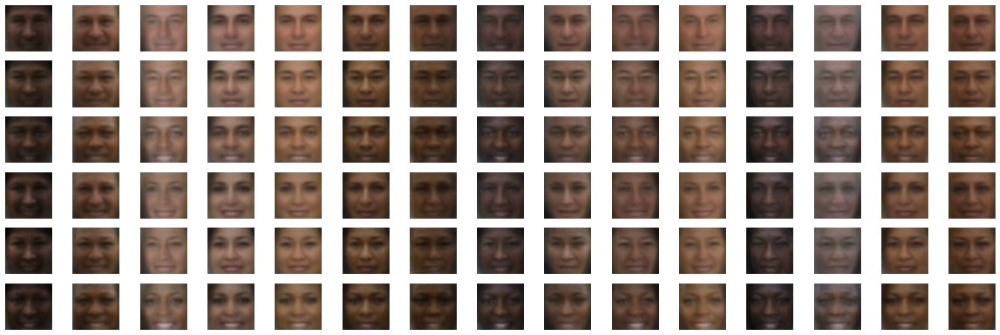

In [ ]:
z = np.array([np.random.normal(0, 1, dim_code) for i in range(15)])
z = np.concatenate( [z, z, z, z, z, z] )
print(z.shape)

label = []

for lst in [ [1, 1, 0, 0], [1, 0, 1, 0], [1, 0, 0, 1],
            [0, 1, 0, 0], [0, 0, 1, 0], [0, 0, 0, 1] ]:
  for i in range(15):
    label.append( lst )

print( np.array(label).shape )

z = torch.Tensor(z).to(device)
label = torch.Tensor(label).to(device)

#output = autoencoder.decoder( torch.cat(  [z, label], dim = 1 ) )
output = autoencoder.decode(z, label )
#print(output.shape)

output = output.view(-1, 45, 45, 3)
output = output.detach().cpu().numpy()

plt.figure(figsize=(24, 8))
for k in range(6):
  for j in range(15):
    plt.subplot(6, 15, k*15 + j + 1)
    plt.imshow(output[k*15 + j] ) 
    plt.axis('off')

2. Меняем стиль картинкам

(90, 4)


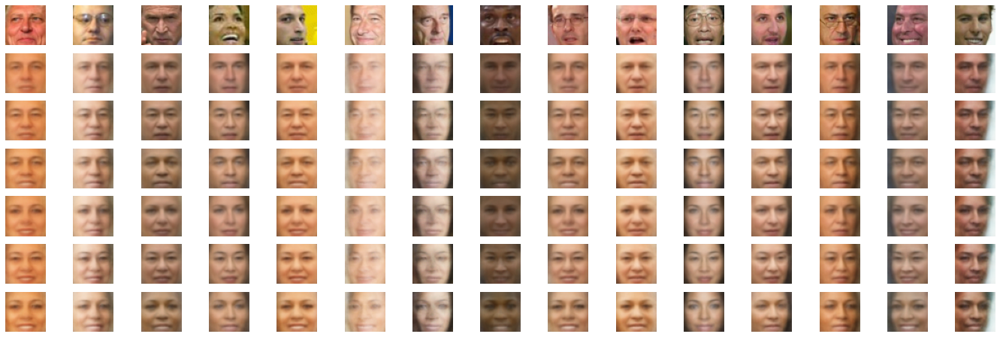

In [ ]:
ind1_ = random.sample(range(len( data_val )), 15)

input = data_val[ ind1_ ]
input = np.concatenate( [input, input, input, input, input, input] )

input = torch.Tensor(input).to(device)

label = []
for lst in [ [1, 1, 0, 0], [1, 0, 1, 0], [1, 0, 0, 1],
            [0, 1, 0, 0], [0, 0, 1, 0], [0, 0, 0, 1] ]:
  for i in range(15):
    label.append( lst )
print( np.array(label).shape )
label = torch.Tensor(label).to(device)

z, logsigma, output = autoencoder(input, label)
#print(output.shape)

output = output.view(-1, 45, 45, 3)
output = output.detach().cpu().numpy()

plt.figure(figsize=(24, 8))
for j in range(15):
    plt.subplot(7, 15, j + 1)
    plt.imshow(data_val[ ind1_[j] ] ) 
    #plt.imshow(input[ j ].detach().cpu().numpy() ) 
    plt.axis('off')
for k in range(6):
  for j in range(15):
    plt.subplot(7, 15, k*15 + j + 1 + 15)
    plt.imshow(output[k*15 + j] ) 
    plt.axis('off')

Splendid! Вы великолепны!

Ну круто же, ну?

## Latent Representations

Давайте посмотрим, как выглядит латентное пространство картинок в CVAE и сравним с картинкой для VAE =)

Опять же, нужно покрасить точки в разные цвета в зависимости от класса.

In [ ]:
#<ваш код получения латентных представлений, применения TSNE и визуализации>

In [ ]:
attr_tr[['gender', 'race_w', 'race_a', 'race_b']].values[0]

array([1, 1, 0, 0])

In [ ]:
embedded = TSNE(n_components=2).fit_transform(  np.concatenate([mu_[:10000], sigma_[:10000]], axis = 1)  )
embedded.shape

(10000, 2)

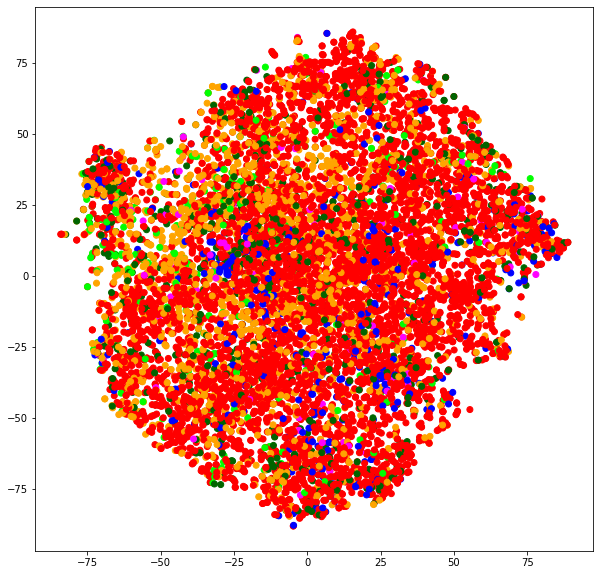

In [ ]:
plt.figure(figsize=(10, 10))

colors = {
(1, 1, 0, 0): 'red',
(0, 1, 0, 0): 'orange',
(1, 0, 1, 0): 'darkgreen',
(0, 0, 1, 0): 'lime',
(1, 0, 0, 1): 'blue',
(0, 0, 0, 1): 'magenta',
#'yellow',
#'silver',
#'xkcd:chocolate',
#'olive'
}


plt.scatter(embedded[:, 0], embedded[:, 1], c = [colors[tuple(i)] for i in attr_tr[['gender', 'race_w', 'race_a', 'race_b']].values[:len(embedded)] ]
            )

Что вы думаете насчет этой картинки? Отличается от картинки для VAE?

1. Мы больше не видим отдельных кластеров. Т.е. автоэнкодер извлекает много информации из меток.
2. В целом видно, что CVAE выучил различие между полами, а также немного расовых оттенков. При этом качество декодирования весьма хромает (по сравнению с обычным автоэнкодером из 1 задания). Увы, наличие шума очень сильно влияет на лица; если изображение цифры при небольших деформациях всё еще будет хорошо интерпретируемым, то с лицами ситуация печальная. Получить хороший декодер на VAE так и не вышло. 
3. Из деталей. Стоит отметить сильную несбалансированность классов, по некоторым группам совсем мало экземпляров. Также хорошо заметны ошибки классификаторов, их немалое количество явно не пошло на пользу

# BONUS 1: Image Morphing (1 балл) 

<a href="https://ibb.co/rxr9YgL"><img src="https://i.ibb.co/D92dhN6/1-6y-Okto2-BUp-ONJpk5x-LRMtw.png" alt="1-6y-Okto2-BUp-ONJpk5x-LRMtw" border="0"></a>

Предлагаю вам поиграться не только с улыбками, но и с получением из одного человека другого!

План:
1. Берем две картинки разных людей из датасета
2. Получаем их латентные представления X и Y
3. Складываем латентные представления с коэффициентом $\alpha$:
  $$\alpha X + (1-\alpha) Y$$
  где $\alpha$ принимает несколько значений от 0 до 1 
4. Визуализируем, как один человек превращается в другого!

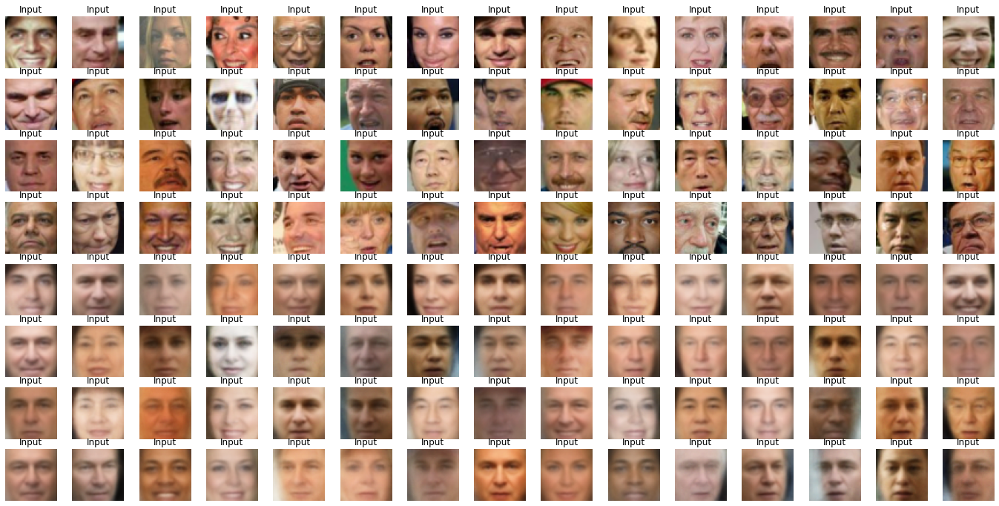

In [ ]:
#<тут ваш код>
plt.figure(figsize=(24, 12))
for k in range(60):
  plt.subplot(8, 15, k+1)
  plt.imshow(data[k].numpy() )
  plt.title('Input')
  plt.axis('off')

  plt.subplot(8, 15, k+1+4*15)
  plt.imshow( 
      autoencoder(data[k].reshape(-1, 45, 45, 3).to(device),
            torch.Tensor( [attr_tr.loc[k, ['gender', 'race_w', 'race_a', 'race_b']]] ).to(device) )[2][0].detach().cpu().numpy()
   )
  plt.title('Input')
  plt.axis('off')

In [ ]:
attr_tr.loc[ [5, 18],  ['gender', 'race_w', 'race_a', 'race_b'] ]

,gender,race_w,race_a,race_b
5,0,1,0,0
18,0,1,0,0


In [ ]:
ind1_ = 5
ind2_ = 18

a = data[ind1_].reshape(-1, 45, 45, 3).to(device)
b = data[ind2_].reshape(-1, 45, 45, 3).to(device)

label = [0, 1, 0, 0]
label = torch.Tensor([label]).to(device)

#print(a.shape, label.shape)
z1, lossigma_ = autoencoder.encode(a, label)
z2, lossigma_ = autoencoder.encode(b, label)

outputs = []

for i in np.arange(0, 1.1, 0.1):
  z = z1 * i + z2 * (1-i)
  outputs.append( autoencoder.decode(z, label) )

len(outputs)

11

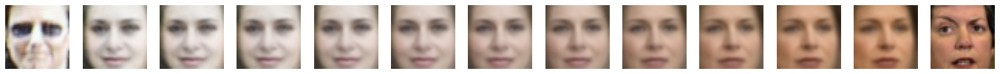

In [ ]:
plt.figure(figsize=(24, 4))
for k in range(13):
  plt.subplot(1, 13, k+1)
  if k == 0:
    plt.imshow(data[ind2_].numpy() )
  elif k == 12:
    plt.imshow(data[ind1_].numpy() )
  else:
    #print( k )
    plt.imshow(outputs[k-1].detach().cpu().numpy()[0] )
  plt.axis('off')

# BONUS 2: Denoising (2 балла) 

У автоэнкодеров, кроме сжатия и генерации изображений, есть другие практические применения. Про одно из них это бонусное задание.

Автоэнкодеры могут быть использованы для избавления от шума на фотографиях (denoising). Для этого их нужно обучить специальным образом: input картинка будет зашумленной, а выдавать автоэнкодер должен будет картинку без шума. 
То есть, loss-функция AE останется той же (MSE между реальной картинкой и выданной), а на вход автоэнкодеру будет подаваться зашумленная картинка.

<a href="https://ibb.co/YbRJ1nZ"><img src="https://i.ibb.co/0QD164t/Screen-Shot-2020-06-04-at-4-49-50-PM.png" alt="Screen-Shot-2020-06-04-at-4-49-50-PM" border="0"></a>

Для того, чтобы поставить эксперимент, нужно взять ваш любимый датасет (датасет лиц или MSE с прошлых заданий или любой другой) и сделать копию этого датасета с шумом. 

В питоне шум можно добавить так:

In [ ]:
noise_factor = 0.5
X_noisy = X + noise_factor * np.random.normal(loc=0.0, scale=1.0, size=X.shape) 
#<тут ваш код обучения автоэнкодера на зашумленных картинках. Не забудтье разбить на train/test!>
#<тут проверка, как AE убирает щум с тестовых картинок. Надеюсь, все получилось =)>

In [ ]:
dim_code = 64 

class Autoencoder(nn.Module):
    def __init__(self):
      super().__init__()
      self.encoder = nn.Sequential( 
          nn.Flatten(start_dim=1),
          nn.Linear(6075, dim_code*8), nn.LeakyReLU(),
          nn.Linear(dim_code*8, dim_code*4), nn.LeakyReLU(),
          nn.Linear(dim_code*4, dim_code)
      )

      self.decoder = nn.Sequential( 
          nn.Linear(dim_code, dim_code*4), nn.LeakyReLU(),
          nn.Linear(dim_code*4, dim_code*8), nn.LeakyReLU(),
          nn.Linear(dim_code*8, 6075), nn.Sigmoid()
      )
        
    def forward(self, x):
        latent_code = self.encoder(x)
        #print( latent_code.shape )
        reconstruction = self.decoder( latent_code ).view( (-1, 45, 45, 3) )
        #print( reconstruction.shape )
        return reconstruction, latent_code

criterion = nn.BCELoss().to(device)

In [ ]:
autoencoder = Autoencoder().to(device)

optimizer = torch.optim.Adam(autoencoder.parameters(), 0.0003)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

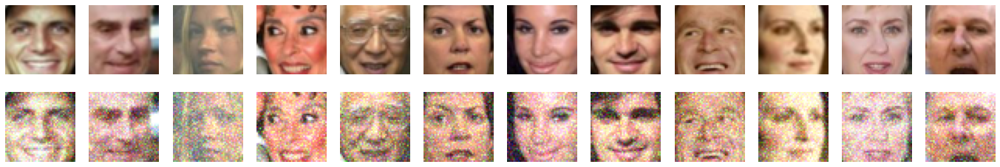

In [ ]:
noise_factor = 0.2

plt.figure(figsize=(24, 4))
for k in range(12):
  test = data[k].numpy()
  plt.subplot(2, 12, k+1)
  plt.imshow(test )
  plt.axis('off')

  plt.subplot(2, 12, k+13)
  plt.imshow(test + abs( noise_factor * np.random.normal(loc=0.0, scale=1.0, size=test.shape) ) )
  plt.axis('off')

In [ ]:
tr_res = []
val_res = []

In [ ]:
input_.max(), input_.min()

(tensor(1.7473, device='cuda:0', dtype=torch.float64),
 tensor(-0.6976, device='cuda:0', dtype=torch.float64))

In [ ]:
torch.clip( input_, 0, 1).max(), torch.clip( input_, 0, 1).min(), torch.clip( input_, 0, 1).median()

(tensor(1., device='cuda:0', dtype=torch.float64),
 tensor(0., device='cuda:0', dtype=torch.float64),
 tensor(0.4881, device='cuda:0', dtype=torch.float64))

In [ ]:
input.max(), input.min()

(tensor(0.9961), tensor(0.))

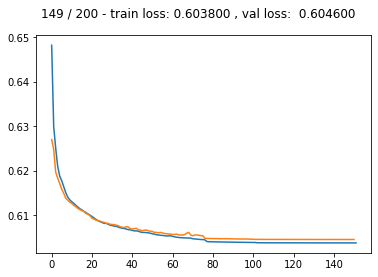

In [ ]:
noise_factor = 0.2

batch_size = 64
batch_size_1 = batch_size

for epoch in range(150):
  if epoch == 75:
    optimizer = torch.optim.Adam(autoencoder.parameters(), 0.00003)
  elif epoch == 100:
    optimizer = torch.optim.Adam(autoencoder.parameters(), 0.000003) 
  elif epoch == 125:
    optimizer = torch.optim.Adam(autoencoder.parameters(), 0.0000003) 


  epoch_err = []
  autoencoder.train()
  for i in range( floor( len(data) / batch_size ) ):
    optimizer.zero_grad()
    input = data[ i * batch_size : (i + 1) * batch_size ]
    input_ = input + noise_factor * np.random.normal(loc=0.0, scale=1.0, size=input.shape)
    input = input.to(device)
    input_ = torch.clip( input_, 0, 1).to(device)

    output = autoencoder(input_.float() )[0]
    err = criterion(output, input)
    err.backward()
    optimizer.step()
    epoch_err.append(err.detach().cpu().numpy() )
  tr_res.append( np.mean(epoch_err)  )

  val_epoch_err = []
  autoencoder.eval()
  with torch.no_grad():
    for i in range( floor( len(data_val) / batch_size_1 ) ):
      input = data_val[ i * batch_size_1 : (i + 1) * batch_size_1 ]
      input_ = input + noise_factor * np.random.normal(loc=0.0, scale=1.0, size=input.shape)
      input = input.to(device)
      input_ = torch.clip( input_, 0, 1).to(device)

      output = autoencoder(input_.float())[0]
      err = criterion(output, input)
      val_epoch_err.append(err.detach().cpu().numpy() )
    val_res.append( np.mean( val_epoch_err) )

  clear_output(wait=True)

  if epoch % 10 != 9:
    plt.figure(figsize=(24, 4))
    for k in range(18):
      test = data_val[k] + noise_factor * np.random.normal(loc=0.0, scale=1.0, size=data_val[k].shape)
      test = torch.clip( test, 0, 1)
      plt.subplot(2, 18, k+1)
      plt.imshow(test.numpy() )
      plt.title('Input')
      plt.axis('off')

      plt.subplot(2, 18, k+19)
      #test = data_val[k].to(device)
      test = autoencoder( test.view( (-1, 45, 45, 3) ).float().to(device) )[0] # 
      test = test.detach().cpu().numpy()
      #print(test.shape)
      plt.imshow(test[0] )
      plt.title('Output')
      plt.axis('off')
    plt.suptitle('%d / %d - train loss: %f , val loss:  %f' % (epoch, 200, round(tr_res[-1], 4), round(val_res[-1], 4)  ))
  else:
    plt.plot(tr_res)
    plt.plot(val_res)
    plt.suptitle('%d / %d - train loss: %f , val loss:  %f' % (epoch, 200, round(tr_res[-1], 4), round(val_res[-1], 4)  ))

  plt.show()

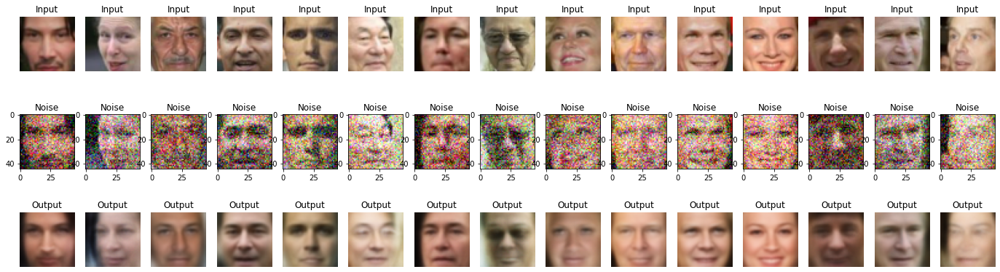

In [ ]:
plt.figure(figsize=(24, 7))
for k in range(15):

  plt.subplot(3, 15, k+1)
  plt.imshow(data_val[k].numpy() )
  plt.title('Input')
  plt.axis('off')

  test = data_val[k]+ noise_factor * np.random.normal(loc=0.0, scale=1.0, size=data_val[k].shape)
  test = torch.clip( test, 0, 1).view( (-1, 45, 45, 3) ).float().to(device)

  plt.subplot(3, 15, k+16)
  plt.imshow(test[0].cpu().numpy() )
  plt.title('Noise')


  plt.subplot(3, 15, k+31)
  #print(test.shape)
  test = autoencoder( test )[0].detach().cpu().numpy()
  #print(test.shape)
  plt.imshow(test[0])
  plt.title('Output')
  plt.axis('off')

## Бонус 2.1: Occlusion (+еще 1 балл)

<a href="https://imgbb.com/"><img src="https://i.ibb.co/wYrKtQY/Screen-Shot-2020-06-04-at-5-06-35-PM.png" alt="Screen-Shot-2020-06-04-at-5-06-35-PM" border="0" width="300" height="300"></a>

Автоэнкодерами можно не только убирать шум, но и восстанавливать части картинки, которые чем-то закрыты! 

Эксперимент здесь такой: вместо наложения шума на картинку, "закрываем" часть картинки заплаткой и тренируем AE/VAE восстанавливать закрытую часть картинки.

Важно, чтобы заплатка была не очень большая. 

In [ ]:
<тут ваш код обучения автоэнкодера на occluded (простите, не знаю, как это сказать по-русски) картинках. Не забудтье разбить на train/test!>

# Bonus 3: Image Retrieval (1 балл)

Давайте представим, что весь наш тренировочный датасет -- это большая база данных людей. И вот мы получили картинку лица какого-то человека с уличной камеры наблюдения (у нас это картинка из тестового датасета) и хотим понять, что это за человек. Что нам делать? Правильно -- берем наш VAE, кодируем картинку в латентное представление и ищем среди латентныз представлений лиц нашей базы самые ближайшие!

План:

1. Получаем латентные представления всех лиц тренировочного датасета
2. Обучаем на них LSHForest (sklearn.neighbors.LSHForest), например, с n_estimators=50
3. Берем картинку из тестового датасета, с помощью VAE получаем ее латентный вектор
4. Ищем с помощью обученного LSHForest ближайшие из латентных представлений тренировочной базы
5. Находим лица тренировочного датасета, которым соответствуют ближайшие латентные представления, визуализируем!

Немного кода вам в помощь: (feel free to delete everything and write your own)

In [ ]:
codes = <поучите латентные представления картинок из трейна>

In [ ]:
# обучаем LSHForest
from sklearn.neighbors import LSHForest
lshf = LSHForest(n_estimators=50).fit(codes)

In [ ]:
def get_similar(image, n_neighbors=5):
  # функция, которая берет тестовый image и с помощью метода kneighbours у LSHForest ищет ближайшие векторы
  # прогоняет векторы через декодер и получает картинки ближайших людей

  code = <получение латентного представления image>
    
  (distances,),(idx,) = lshf.kneighbors(code, n_neighbors=n_neighbors)

  return distances, X_train[idx]

In [ ]:
def show_similar(image):

  # функция, которая принимает тестовый image, ищет ближайшие к нему и визуализирует результат
    
    distances,neighbors = get_similar(image,n_neighbors=11)
    
    plt.figure(figsize=[8,6])
    plt.subplot(3,4,1)
    plt.imshow(image.cpu().numpy().transpose([1,2,0]))
    plt.title("Original image")
    
    for i in range(11):
        plt.subplot(3,4,i+2)
        plt.imshow(neighbors[i].cpu().numpy().transpose([1,2,0]))
        plt.title("Dist=%.3f"%distances[i])
    plt.show()

In [ ]:
<тут выведите самые похожие лица к какому-нибудь лицу из тестовой части датасета>

# Bonus 4: Телеграм-бот (3 балла)

Вы можете написать телеграм-бота с функционалом AE. Например, он может добавлять к вашей фотографии улыбку или искать похожие на ваше лицо лица среди лиц датасета. 

Код бота должно быть можно проверить!

# Эпилог

здесь мы рассмотрели не все применения автоэнкодеров. Еще есть, например:

-- поиск аномалий
-- дополнение отсутствующих частей картины
-- работа с sequential данными (например, временными рядами)
-- гибриды ГАН+АЕ, которые активно изучаются в последнее время
-- использование латентных переменных АЕ в качестве фичей
...

Они не были частью этого проекта, потому что для их реализации пришлось бы больше возиться с датасетами. 

Но! Если вы хотите, вы, конечно, всегда можете реализовать еще что-то и получить за это еще допбаллы.

Надеюсь, вам понравилось!